# Stage 1 analysis; Long wavelength Spectroscopy

In [94]:
import sys, os, time                                                            
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits

from importlib import reload                                                    
import eureka.S1_detector_processing.s1_process as s1                                 
from eureka.lib import readECF as rd                                            
from eureka.lib import logedit                                                  
from eureka.lib import readECF as rd                                            
from eureka.lib import manageevent as me                                        
#from eureka.S1_data_reduction import optspex                                    
from eureka.lib import astropytable                                             
from eureka.lib import util   

plt.rcParams['font.size'] = 15
plt.rcParams['lines.markersize'] = 2

In [95]:
# Starts timer to monitor how long data reduction takes
t0      = time.time()

# Names the event (has to match the event name used for the *.ecf files)
eventlabel = 'wasp39b'                                                           

In [96]:
!ls 'dc-roof'

ideal_one_over_f_nirspec_format.fits
ideal_one_over_f_nirspec_format_lin_corr.fits
ideal_one_over_f_nirspec_format_med_corr.fits
jwdata0010010_11010_0001_NRS1_uncal_updatedHDR_10INTS.fits
jwdata0010010_11010_0001_NRS1_uncal_updatedHDR_10INTS_ramp.fits
jwdata0010010_11010_0001_NRS1_uncal_updatedHDR_10INTS_ramp_SKIPJUMP.fits
jwdata0010010_11010_0001_NRS1_uncal_updatedHDR_10INTS_ramp_STOPAFTERBIAS.fits
jwdata0010010_11010_0001_NRS1_uncal_updatedHDR_10INTS_ramp_STOPAFTERBIAS_add_lin_corr.fits
jwdata0010010_11010_0001_NRS1_uncal_updatedHDR_10INTS_ramp_STOPAFTERBIAS_add_med_corr.fits


In [97]:
hdul = fits.open("dc-roof/ideal_one_over_f_nirspec_format.fits")
#"dc-roof/jwdata0010010_11010_0001_NRS1_uncal_updatedHDR_10INTS_ramp_STOPAFTERBIAS.fits")
hdul.info()

Filename: dc-roof/ideal_one_over_f_nirspec_format.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     209   ()      
  1  SCI           1 ImageHDU        50   (512, 32, 5, 10)   float64   
  2  PIXELDQ       1 ImageHDU        11   (512, 32)   int32 (rescales to uint32)   
  3  GROUPDQ       1 ImageHDU        11   (512, 32, 3, 10)   uint8   
  4  ERR           1 ImageHDU        11   (512, 32, 3, 10)   float32   
  5  ASDF          1 BinTableHDU     11   1R x 1C   [6414B]   


In [98]:
hdul[1].data

array([[[[-1.14159935e+01, -1.39551005e+01, -6.47863105e+00, ...,
          -3.62856943e+00, -2.01631270e+01, -9.15988222e+00],
         [-2.10330954e+01, -1.68757796e+01,  4.12879878e-01, ...,
          -1.09402902e+01, -2.47653465e+01, -3.23265229e+00],
         [ 1.39912040e+01,  1.68574372e+00, -1.70628644e+01, ...,
          -1.04414492e+01, -2.73544544e+00, -7.02615065e+00],
         ...,
         [-7.05521996e+00,  1.09876492e+01, -2.72976354e+01, ...,
          -3.15993423e+01,  1.29338708e+01, -8.27359208e+00],
         [-3.09636640e+01,  8.32229342e+00, -3.01036798e+01, ...,
          -1.06024120e+01, -1.78768546e+01, -8.60178949e+00],
         [ 1.74167089e+01,  1.79489389e+00,  4.56512979e+00, ...,
          -4.09428863e+01, -2.40013242e+01, -1.82355976e+01]],

        [[ 1.38204934e+01,  7.43426265e+00, -1.62284003e+00, ...,
           1.36786720e+01, -6.40417935e+00,  2.73353951e+00],
         [-3.48289967e+00, -2.29778338e+00,  6.91925085e+00, ...,
           1.12660203e

In [99]:
hdul[0].header

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                    8 / array data type                                
NAXIS   =                    0 / number of array dimensions                     
EXTEND  =                    T                                                  
DATE    = '2022-03-21T19:37:31.874' / UTC date file created                     
ORIGIN  = 'STScI   '           / Organization responsible for creating file     
FILENAME= 'jwdata0010010_11010_0001_NRS1_uncal_updatedHDR_10INTS_ramp.fits' / Na
FILETYPE= 'countrate'          / Type of data in the file                       
SDP_VER = 'B7.0    '           / Data processing software version number        
CAL_VER = '1.3.3   '           / Calibration software version number            
CAL_VCS = 'RELEASE '           / Calibration software version control sys number
DATAMODL= 'RampModel'          / Type of data model                             
TELESCOP= 'JWST    '        

In [100]:
print(np.shape(hdul[1].data[:,:,1,:,]))

np.shape(hdul[1].data[:,:,:,:,])

(10, 5, 512)


(10, 5, 32, 512)

In [101]:
time_np = np.arange(0, 320, 10)/1000
time_full = [time_np.copy()]
print(time_full)

for i in np.arange(1,rowsize):
    #print(i)
    #print(time_np.copy()+(120)+time_full[-1][-1])
    time_full.append(time_np.copy()+120/1000+time_full[-1][-1])
    
    
time_full_flat = [item for sublist in time_full for item in sublist]
time_full_flat = np.array(time_full_flat)

[array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
       0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21,
       0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3 , 0.31])]


0
1
2
3
4
5
6
7
8
9


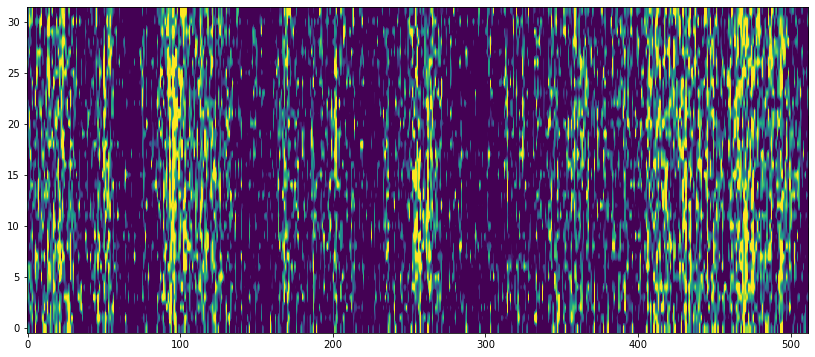

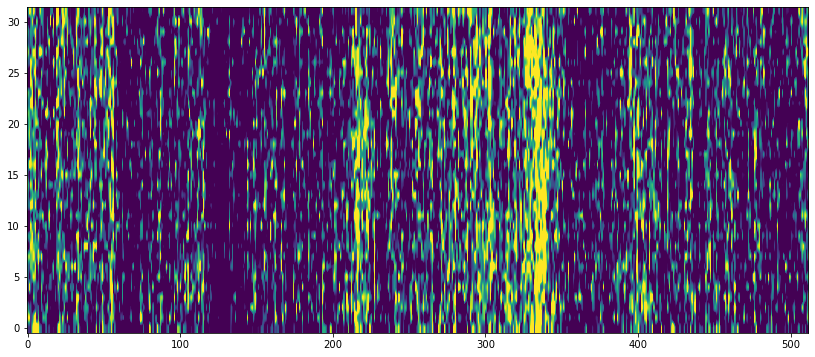

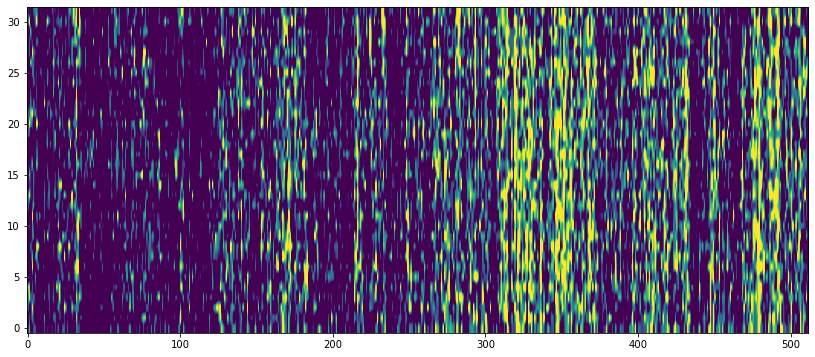

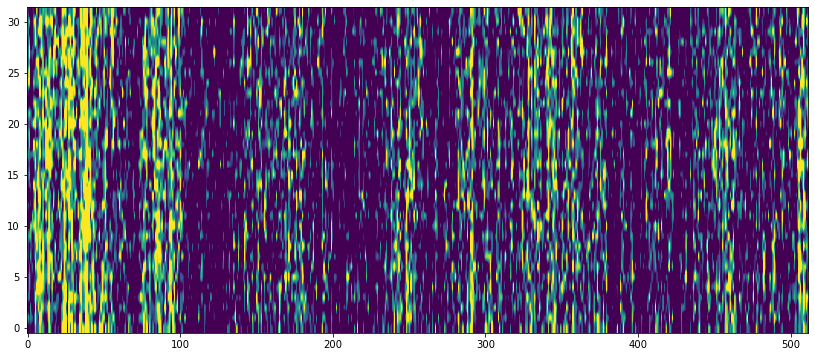

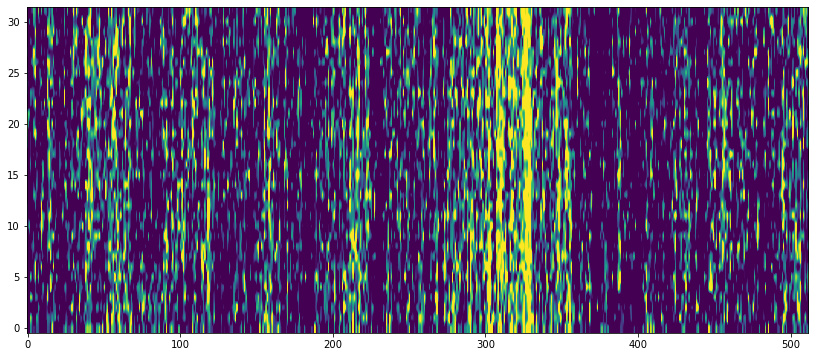

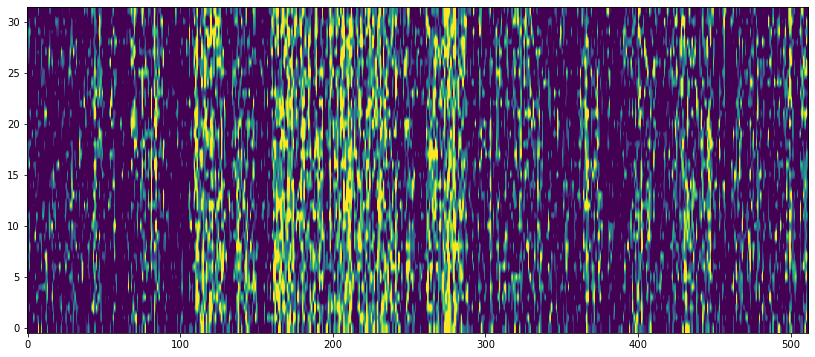

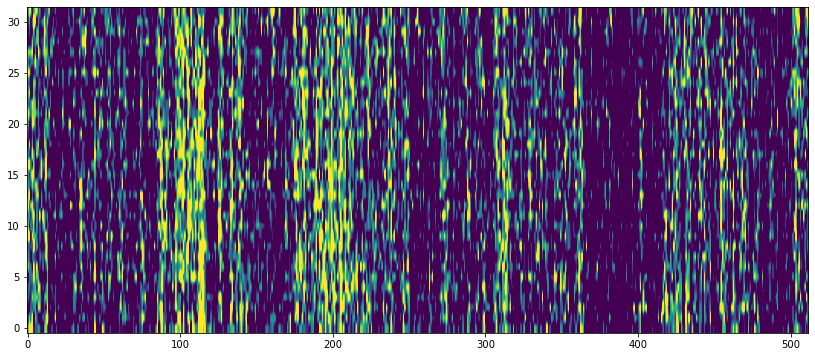

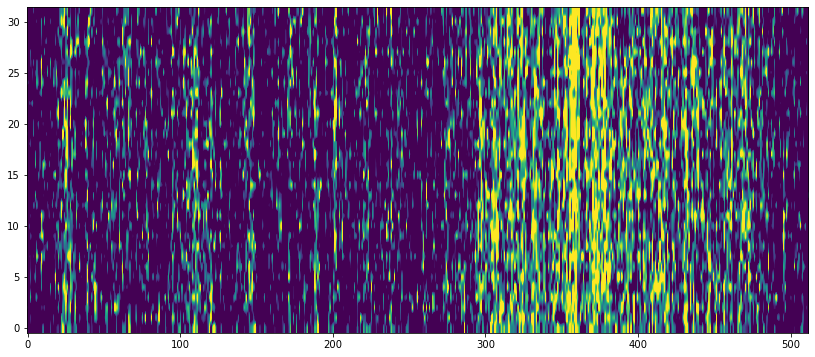

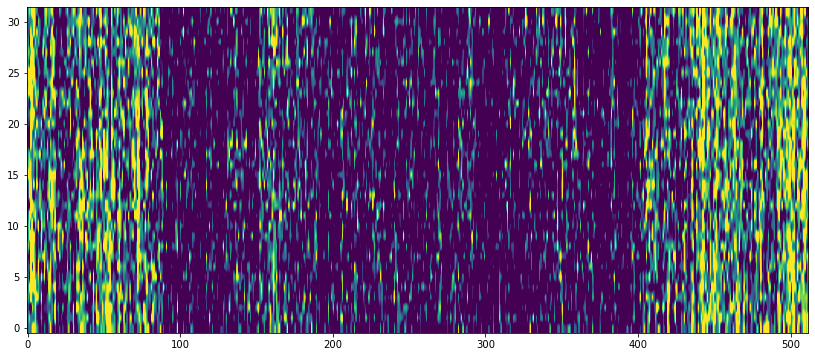

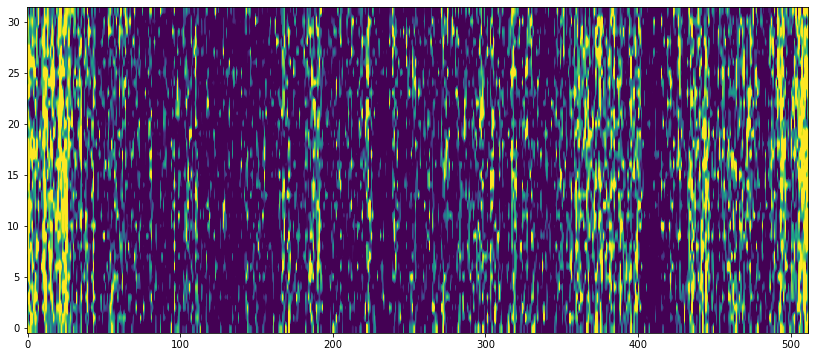

In [122]:
%matplotlib inline
for i in range(0, 10):
    print(i)
    fig, ax = plt.subplots(1, 1, figsize=(14, 6))
    plt.imshow(hdul[1].data[i,1,:,:,], origin = 'lower', aspect='auto',  vmin=0, vmax=20)

In [103]:
# Sum the rows and columns for group 0

def row_col_counter(colsize, rowsize, group_num, integr_num):
    col_arrays = []
    col_values = np.zeros(colsize)

    for col_num in range(0, rowsize):
        for row_num in range(0,colsize):
            col_values[row_num] = hdul[1].data[integr_num,group_num,row_num,col_num]
        col_arrays.append(col_values.tolist())

    col_arrays_flat = [item for sublist in col_arrays for item in sublist]
    
    return col_arrays, np.array(col_arrays_flat)


In [104]:
colsize = hdul[0].header['SUBSIZE2']
rowsize = hdul[0].header['SUBSIZE1']

col_arrays0, col_arrays_flat0 = row_col_counter(colsize, rowsize, group_num=0, integr_num=0)
col_arrays1, col_arrays_flat1 = row_col_counter(colsize, rowsize, group_num=0, integr_num=1)
col_arrays2, col_arrays_flat2 = row_col_counter(colsize, rowsize, group_num=0, integr_num=2)
col_arrays3, col_arrays_flat3 = row_col_counter(colsize, rowsize, group_num=0, integr_num=3)
col_arrays4, col_arrays_flat4 = row_col_counter(colsize, rowsize, group_num=0, integr_num=4)
col_arrays5, col_arrays_flat5 = row_col_counter(colsize, rowsize, group_num=0, integr_num=5)
col_arrays6, col_arrays_flat6 = row_col_counter(colsize, rowsize, group_num=0, integr_num=6)
col_arrays7, col_arrays_flat7 = row_col_counter(colsize, rowsize, group_num=0, integr_num=7)
col_arrays8, col_arrays_flat8 = row_col_counter(colsize, rowsize, group_num=0, integr_num=8)
col_arrays9, col_arrays_flat9 = row_col_counter(colsize, rowsize, group_num=0, integr_num=9)

<IPython.core.display.Javascript object>


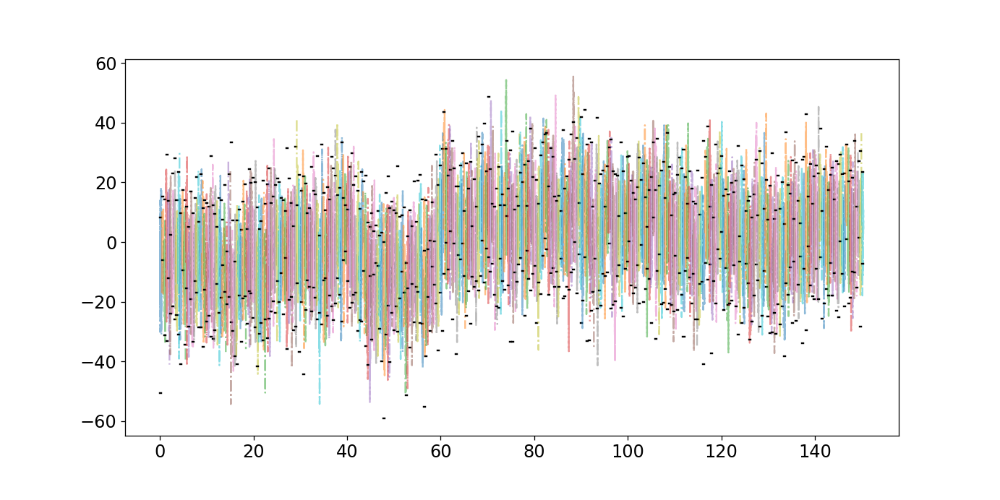

-21.0726871663283 -10.502731629344751
14.695929093304095
-14.101213406806778 4.625663328625539
left is bigger than right
5.347778957296166
5.347778957296166
-6.171706168620217 -15.400372766938476
11.381435893568183
1.379121638081278 -2.5496412639184474
15.639556753455702
0.7968712845248738 -8.658333729605307
right is bigger than left
6.468362767896785
-9.93886072588419 -11.8774405736606
6.583675226370919
-6.314168453670648 3.418188646886742
11.180984121867207
8.637168856365097 -14.717357836848246
13.54135083519945
-7.542318767467639 -7.9785430222915235
9.610783723590053
-4.913186786595053 1.9977169511849846
13.596457067955566
-5.6063191940039205 -15.356234675547752
12.611814349345138
4.008209896366735 -12.584254936916771
right is bigger than left
6.738765661976736
-9.996803197213321 -13.717548602094617
12.098211309416776
13.693260270330526 -1.762432001335433
left is bigger than right
6.880964095215379
6.880964095215379
-13.386851356425606 -15.38594205007174
8.370199890267115
-6.7933348

-6.883206743255434 -4.149751388778682
9.27356325082307
-6.585430595716868 -11.109437470730722
10.07308452824219
-11.204289231431872 -6.428620258327514
7.810722294077255
-2.3635090888491606 -13.709367678824865
right is bigger than left
13.85188546236588
-5.142798519270294 -24.94080808734723
right is bigger than left
6.825004738746373
-0.5021450635474929 -6.037417352036645
right is bigger than left
4.713767992943007
-2.5906400162787397 -14.659807584227202
right is bigger than left
7.115686523228384
-27.96739059587693 -29.176918091254237
11.107493266098066
-32.082644292232075 -6.7760128603303365
left is bigger than right
4.363879177336925
4.363879177336925
-8.417341382575172 -8.813945914784144
11.488092477437243
-4.334649119913706 -14.12292126888762
right is bigger than left
4.795329290430371
5.333867424579857 -12.185342163059293
11.761871067522094
-4.098743763670626 -16.413740469492662
right is bigger than left
5.439912142753755
-19.957266754616676 1.9922095666010613
left is bigger than 

8.769585627337845
11.741884739972491 12.428978950570691
7.129380432830364
9.356480064201929 7.161965248634122
8.75145395731341
6.330037483348578 -7.997558922414621
8.432529477299198
4.20341770657508 -0.3953702569894988
left is bigger than right
7.370910083776595
7.370910083776595
7.034869400488513 4.085505484778178
6.509469911539524
6.103271059164522 7.306548293336772
12.193491897128974
10.79875219164561 12.92858964054054
5.417802809931747
3.133803247889888 12.828513175109059
right is bigger than left
11.645115858737576
13.032816157700523 -0.3554900026822174
left is bigger than right
7.63474999156502
7.63474999156502
-1.9862590269830263 6.101894555407604
right is bigger than left
3.527793080665151
10.556882213179682 2.6164964689260675
left is bigger than right
7.424712335883322
7.424712335883322
-2.6364318381330043 12.442865264069603
right is bigger than left
12.1827363887879
27.64550972285886 17.647368585440407
6.295250558872056
23.11854680290432 -7.450014746068507
left is bigger than

-6.138285194903513 11.85624875042279
14.709907009021427
16.850834682701304 5.811029929182094
7.727958577888007


In [105]:
# test median, sigma subtraction
%matplotlib notebook
fig, ax = plt.subplots(1, 1, figsize=(12, 6))#25, 6))


for i in np.arange(0, 350):#0, len(col_arrays0)):
    median_col_left = np.mean(np.array(col_arrays0[i])[np.array([0, 1,3,4])])
    median_col_right = np.mean(np.array(col_arrays0[i])[np.array([28,29, 30, 31])])
    
    print(median_col_left, median_col_right)
    
    # Check if there is a bad pixel on the left
    if np.abs(median_col_left) > 3*np.abs(median_col_right):
        median_col = median_col_right.copy()
        sig_col = np.std(np.array(col_arrays0[i])[np.array([28,29, 30, 31])])
        print("left is bigger than right")
        print(sig_col)
    elif np.abs(median_col_right) > 3*np.abs(median_col_left):
        median_col = median_col_left.copy()
        sig_col = np.std(np.array(col_arrays0[i])[np.array([0, 1,3, 4])])
        print("right is bigger than left")
    else:
        median_col = np.median(np.array(col_arrays0[i])[np.array([0, 1,3,4,28,29, 30, 31])])
        sig_col = np.std(np.array(col_arrays0[i])[np.array([0, 1,3, 4, 28, 29, 30, 31])])
    
    print(sig_col)
    plt.plot(time_full[i], col_arrays0[i], "-.", alpha=0.5)
    plt.plot(time_full[i], [median_col+2*sig_col]*len(time_full[i]), color='k')
    plt.plot(time_full[i], [median_col-2*sig_col]*len(time_full[i]), color='k')

<IPython.core.display.Javascript object>


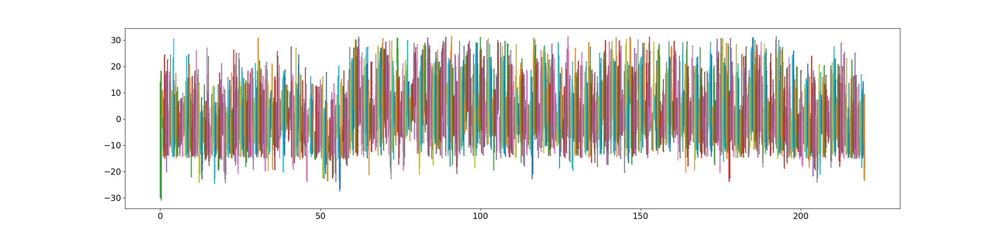

In [106]:
    #%matplotlib inline
    %matplotlib notebook
    time_arrays = []
    col_mask_arrays = []
    time_mask_arrays = []
    col_values_list =[]
    image =  np.zeros((10, 3, 32, 512))
    image_masked = np.zeros((10, 3, 32, 512))

    integr_nums = 1#10
    group_nums = 1
    rowsize = 512
    
    
    
    for group_num in range(0, group_nums):
        for integr_num in range(0, integr_nums):
            fig, ax = plt.subplots(1, 1, figsize=(25, 6))
            for col_num in range(0, rowsize):
            
            
                #integr_num = 0
                #group_num = 0
                #col_num = 0
                
                #print(integr_num,group_num,col_num)
                
                time = time_full[col_num]
                time_arrays.append(time)
                
                col_values= hdul[1].data[integr_num,group_num,:,col_num]
                image[integr_num,group_num,:,col_num] = hdul[1].data[integr_num,group_num,:,col_num]
                col_values_list.append(col_values)

                
                # add in masking HERE
                median_col_left = np.mean(np.array(col_values)[np.array([0, 1,3,4])])
                median_col_right = np.mean(np.array(col_values)[np.array([28,29, 30, 31])])

                #print(median_col_left, median_col_right)

                # Check if there is a bad pixel on the left
                if np.abs(median_col_left) > 3*np.abs(median_col_right):
                    median_col = median_col_right.copy()
                    sig_col = np.std(np.array(col_arrays0[i])[np.array([28,29, 30, 31])])
                    #print("left is bigger than right")
                    #print(sig_col)
                elif np.abs(median_col_right) > 3*np.abs(median_col_left):
                    median_col = median_col_left.copy()
                    sig_col = np.std(np.array(col_arrays0[i])[np.array([0, 1,3, 4])])
                    #print("right is bigger than left")
                else:
                    median_col = np.median(np.array(col_arrays0[i])[np.array([0, 1,3,4,28,29, 30, 31])])
                    sig_col = np.std(np.array(col_arrays0[i])[np.array([0, 1,3, 4, 28, 29, 30, 31])])

                min_cutoff = median_col-3*sig_col
                max_cutoff = median_col+3*sig_col
                
                col_masked_values = col_values[np.where((col_values>min_cutoff)&(col_values<max_cutoff))]
                col_mask_arrays.append(col_masked_values)
                
                time_masked = time[np.where((col_values>min_cutoff)&(col_values<max_cutoff))]
                time_mask_arrays.append(time_masked)
                
                #plt.plot(time, col_values, ".-")
                plt.plot(time_masked, col_masked_values, ".-")#, color='k')
            
                
                #image_masked[integr_num,group_num,:,col_num] = col_masked_values

In [107]:
# median, sigma subtraction

def median_sig_cleanup(integr_nums, group_nums, rowsize):
    
    time_arrays = []
    col_mask_arrays = []
    time_mask_arrays = []
    col_values_list =[]
    image =  np.zeros((10, 3, 32, 512))
    image_masked = np.zeros((10, 3, 32, 512))
    
    for group_num in range(0, group_nums):
        for integr_num in range(0, integr_nums):
            for col_num in range(0, rowsize):
                
                #print(integr_num,group_num,col_num)
                time = time_full[col_num]
                time_arrays.append(time)
                
                col_values= hdul[1].data[integr_num,group_num,:,col_num]
                image[integr_num,group_num,:,col_num] = hdul[1].data[integr_num,group_num,:,col_num]
                col_values_list.append(col_values)

                
                # add in masking HERE
                median_col_left = np.mean(np.array(col_values)[np.array([0, 1,3,4])])
                median_col_right = np.mean(np.array(col_values)[np.array([28,29, 30, 31])])

                #print(median_col_left, median_col_right)

                # Check if there is a bad pixel on the left
                if np.abs(median_col_left) > 3*np.abs(median_col_right):
                    median_col = median_col_right.copy()
                    sig_col = np.std(np.array(col_arrays0[i])[np.array([28,29, 30, 31])])
                    #print("left is bigger than right")
                    #print(sig_col)
                elif np.abs(median_col_right) > 3*np.abs(median_col_left):
                    median_col = median_col_left.copy()
                    sig_col = np.std(np.array(col_arrays0[i])[np.array([0, 1,3, 4])])
                    #print("right is bigger than left")
                else:
                    median_col = np.median(np.array(col_arrays0[i])[np.array([0, 1,3,4,28,29, 30, 31])])
                    sig_col = np.std(np.array(col_arrays0[i])[np.array([0, 1,3, 4, 28, 29, 30, 31])])

                min_cutoff = median_col-3*sig_col
                max_cutoff = median_col+3*sig_col
                
                col_masked_values = col_values[np.where((col_values>min_cutoff)&(col_values<max_cutoff))]
                #image_masked[integr_num,group_num,:,col_num] = col_masked_values
                col_mask_arrays.append(col_masked_values.tolist())
                
                time_masked = time[np.where((col_values>min_cutoff)&(col_values<max_cutoff))]
                time_mask_arrays.append(time_masked.tolist())
                
                #print(len(time_masked), len(col_masked_values))
                #print(image_corr)
                                
    
    #masked_times = np.array([],[])
    #masked_cols = np.array([],[])
    
    return time_mask_arrays, col_mask_arrays, col_values_list, image#, image_masked

In [108]:
time_mask_arrays, col_mask_arrays, col_values_list, image = median_sig_cleanup(integr_nums=10, 
                                                                                           group_nums=3,
                                                                                           rowsize=1)#512)


In [109]:

plt.plot(time_np, col_arrays0[0])

<IPython.core.display.Javascript object>


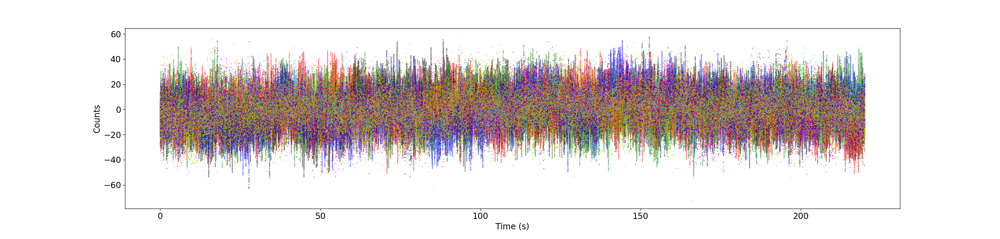

Text(0, 0.5, 'Counts')

In [110]:
# plot the ten different integrations
#%matplotlib inline
fig, ax = plt.subplots(1, 1, figsize=(25, 6))

for i in np.arange(0, len(col_arrays0)):
    plt.plot(time_full[i], col_arrays0[i], "-.", color='k', alpha=0.5)
    plt.plot(time_full[i], col_arrays1[i], "-.", color='g', alpha=0.5)
    plt.plot(time_full[i], col_arrays2[i], "-.", color='r', alpha=0.5)
    plt.plot(time_full[i], col_arrays3[i], "-.", color='b', alpha=0.5)
    plt.plot(time_full[i], col_arrays4[i], ".", color='purple', alpha=0.5)
    plt.plot(time_full[i], col_arrays5[i], ".", color='lawngreen', alpha=0.5)
    plt.plot(time_full[i], col_arrays6[i], ".", color='fuchsia', alpha=0.5)
    plt.plot(time_full[i], col_arrays7[i], ".", color='turquoise', alpha=0.5)
    plt.plot(time_full[i], col_arrays8[i], ".", color='orange', alpha=0.5)
    plt.plot(time_full[i], col_arrays9[i], ".", color='y', alpha=0.5)
    #plt.xlim(0, 6000)
    #plt.ylim(-50, 400)
    
plt.xlabel("Time (s)")
plt.ylabel("Counts")

In [111]:
xmin = 40550
ymin = 180

xmax = 183500
ymax = 16000


def index_mask_finder(col_arrays_flat, ymin):
    indexes_keep = (np.array(col_arrays_flat0)<ymin).nonzero()[0]
    return indexes_keep

def masked_time_col(col_arrays_flat, ymin):
    indexes_keep = (np.array(col_arrays_flat)<ymin).nonzero()[0]
    return time_full_flat[index_mask_finder(col_arrays_flat, ymin)].tolist(), col_arrays_flat[index_mask_finder(col_arrays_flat, ymin)].tolist()


<IPython.core.display.Javascript object>


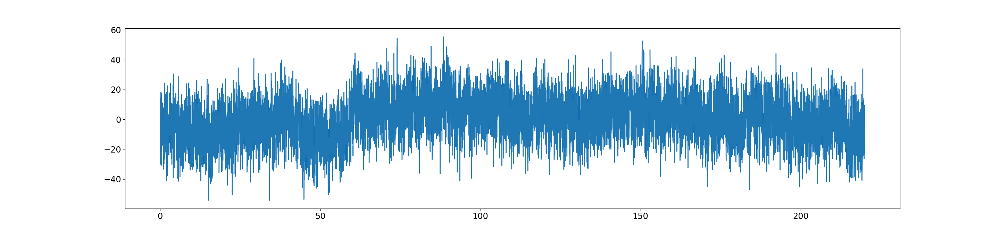

In [112]:
fig, ax = plt.subplots(1, 1, figsize=(25, 6))


plt.plot(time_full_flat[np.where(np.array(col_arrays_flat0)<ymin)], col_arrays_flat0[np.where(np.array(col_arrays_flat0)<ymin)])


#plt.plot(time_full_flat[np.where(np.array(col_arrays_flat1)<ymin)], col_arrays_flat1[np.where(np.array(col_arrays_flat1)<ymin)])
#plt.plot(time_full_flat[np.where(np.array(col_arrays_flat2)<ymin)], col_arrays_flat2[np.where(np.array(col_arrays_flat2)<ymin)])
#plt.plot(time_full_flat[np.where(np.array(col_arrays_flat3)<ymin)], col_arrays_flat3[np.where(np.array(col_arrays_flat3)<ymin)])
#plt.plot(time_full_flat[np.where(np.array(col_arrays_flat4)<ymin)], col_arrays_flat4[np.where(np.array(col_arrays_flat4)<ymin)])
#plt.plot(time_full_flat[np.where(np.array(col_arrays_flat5)<ymin)], col_arrays_flat5[np.where(np.array(col_arrays_flat5)<ymin)])
#plt.plot(time_full_flat[np.where(np.array(col_arrays_flat6)<ymin)], col_arrays_flat6[np.where(np.array(col_arrays_flat6)<ymin)])




<IPython.core.display.Javascript object>


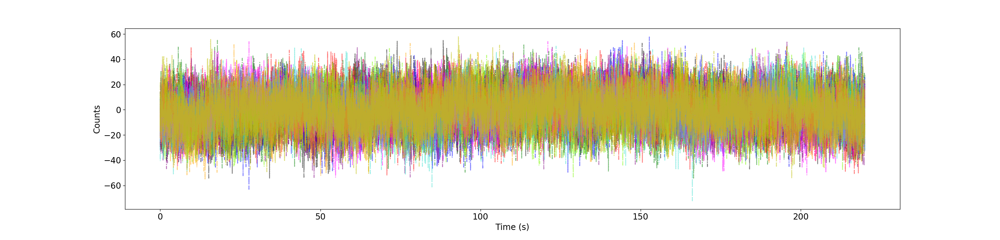

Text(0, 0.5, 'Counts')

In [113]:
%matplotlib notebook
fig, ax = plt.subplots(1, 1, figsize=(25, 6))

plt.plot(time_full_flat[index_mask_finder(col_arrays_flat0, ymin)], 
         col_arrays_flat0[index_mask_finder(col_arrays_flat0, ymin)], "-.", color='k', alpha=0.5)
plt.plot(time_full_flat[index_mask_finder(col_arrays_flat1, ymin)], 
         col_arrays_flat1[index_mask_finder(col_arrays_flat1, ymin)], "-.", color='green', alpha=0.5)
plt.plot(time_full_flat[index_mask_finder(col_arrays_flat2, ymin)], 
         col_arrays_flat2[index_mask_finder(col_arrays_flat2, ymin)], "-.", color='r', alpha=0.5)
plt.plot(time_full_flat[index_mask_finder(col_arrays_flat3, ymin)], 
         col_arrays_flat3[index_mask_finder(col_arrays_flat3, ymin)], "-.", color='b', alpha=0.5)
plt.plot(time_full_flat[index_mask_finder(col_arrays_flat4, ymin)], 
         col_arrays_flat4[index_mask_finder(col_arrays_flat4, ymin)], "-.", color='purple', alpha=0.5)
plt.plot(time_full_flat[index_mask_finder(col_arrays_flat5, ymin)], 
         col_arrays_flat5[index_mask_finder(col_arrays_flat5, ymin)], "-.", color='lawngreen', alpha=0.5)
plt.plot(time_full_flat[index_mask_finder(col_arrays_flat6, ymin)], 
         col_arrays_flat6[index_mask_finder(col_arrays_flat6, ymin)], "-.", color='fuchsia', alpha=0.5)
plt.plot(time_full_flat[index_mask_finder(col_arrays_flat7, ymin)], 
         col_arrays_flat7[index_mask_finder(col_arrays_flat7, ymin)], "-.", color='turquoise', alpha=0.5)
plt.plot(time_full_flat[index_mask_finder(col_arrays_flat8, ymin)], 
         col_arrays_flat8[index_mask_finder(col_arrays_flat8, ymin)], "-.", color='orange', alpha=0.5)
plt.plot(time_full_flat[index_mask_finder(col_arrays_flat9, ymin)], 
         col_arrays_flat9[index_mask_finder(col_arrays_flat9, ymin)], "-.", color='y', alpha=0.5)
#plt.xlim(0, 6000)
#plt.ylim(-50, 400)
    
plt.xlabel("Time (s)")
plt.ylabel("Counts")

## extract masked times and column counts

In [114]:
masked_time0, maskedcol_arrays0 = masked_time_col(col_arrays_flat0, ymin)
masked_time1, maskedcol_arrays1 = masked_time_col(col_arrays_flat1, ymin)
masked_time2, maskedcol_arrays2 = masked_time_col(col_arrays_flat2, ymin)
masked_time3, maskedcol_arrays3 = masked_time_col(col_arrays_flat3, ymin)
masked_time4, maskedcol_arrays4 = masked_time_col(col_arrays_flat4, ymin)
masked_time5, maskedcol_arrays5 = masked_time_col(col_arrays_flat5, ymin)
masked_time6, maskedcol_arrays6 = masked_time_col(col_arrays_flat6, ymin)
masked_time7, maskedcol_arrays7 = masked_time_col(col_arrays_flat7, ymin)
masked_time8, maskedcol_arrays8 = masked_time_col(col_arrays_flat8, ymin)
masked_time9, maskedcol_arrays9 = masked_time_col(col_arrays_flat9, ymin)

all_masked_times = np.array([masked_time0, masked_time1, masked_time2, masked_time3, masked_time4, masked_time5,
                            masked_time6, masked_time7, masked_time8, masked_time9])
all_masked_cols = np.array([maskedcol_arrays0, maskedcol_arrays1, maskedcol_arrays2, maskedcol_arrays3, maskedcol_arrays4,
                            maskedcol_arrays5, maskedcol_arrays6, maskedcol_arrays7, maskedcol_arrays8, maskedcol_arrays9])
    

## Periodogram

In [115]:
%matplotlib inline
# import packages
from astropy.timeseries import LombScargle
from astropy.timeseries import TimeSeries
from astropy.table import Table
from astropy.time import Time
import astropy.units as u

min freq: 0.00045446282494091483 max freq: 186.14842755862364
best period: 318.4446314728288
min freq: 0.00045446282494091483 max freq: 186.14842755862364
best period: 107.48794746938471
min freq: 0.00045446282494091483 max freq: 186.14842755862364
best period: 36.992046730546136
min freq: 0.00045446282494091483 max freq: 186.14842755862364
best period: 227.5304618065257
min freq: 0.00045446282494091483 max freq: 186.14842755862364
best period: 42.645696867355475
min freq: 0.00045446282494091483 max freq: 186.14842755862364
best period: 52.44666931339729
min freq: 0.00045446282494091483 max freq: 186.14842755862364
best period: 116.1584428411465
min freq: 0.00045446282494091483 max freq: 186.14842755862364
best period: 77.29883896121605
min freq: 0.00045446282494091483 max freq: 186.14842755862364
best period: 260.614645999654
min freq: 0.00045446282494091483 max freq: 186.14842755862364
best period: 157.4009116418526


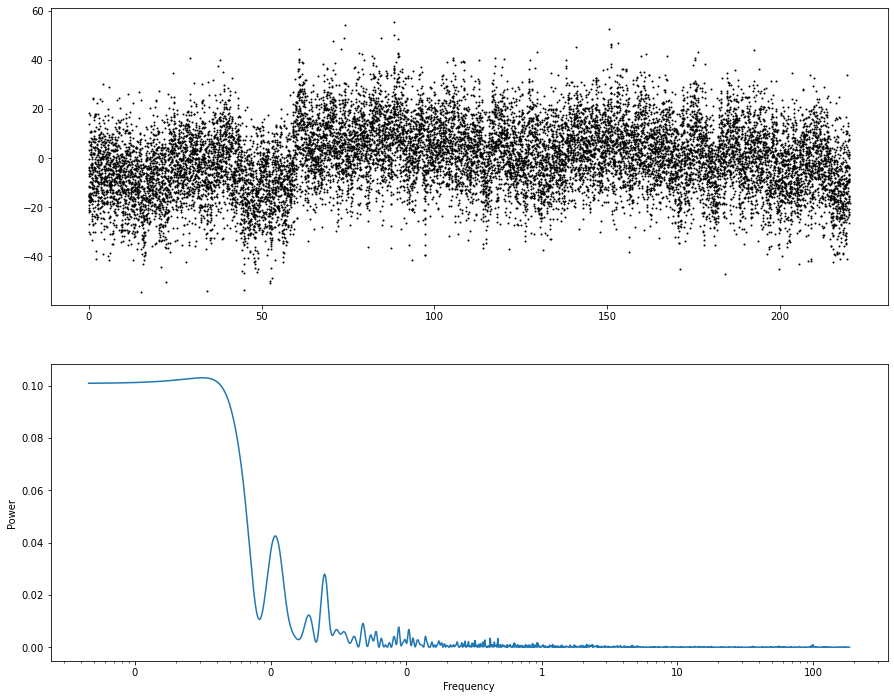

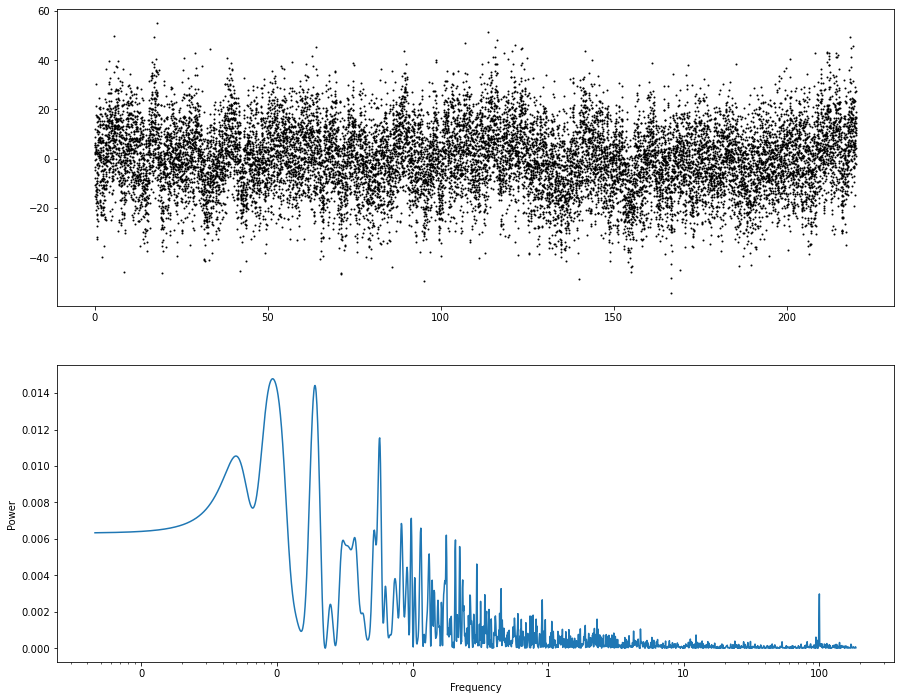

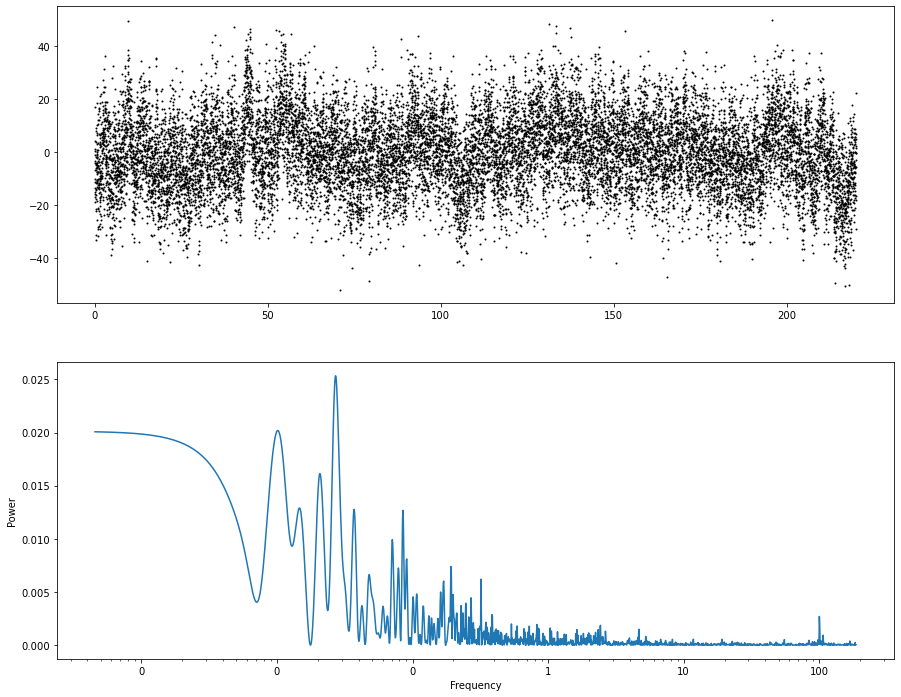

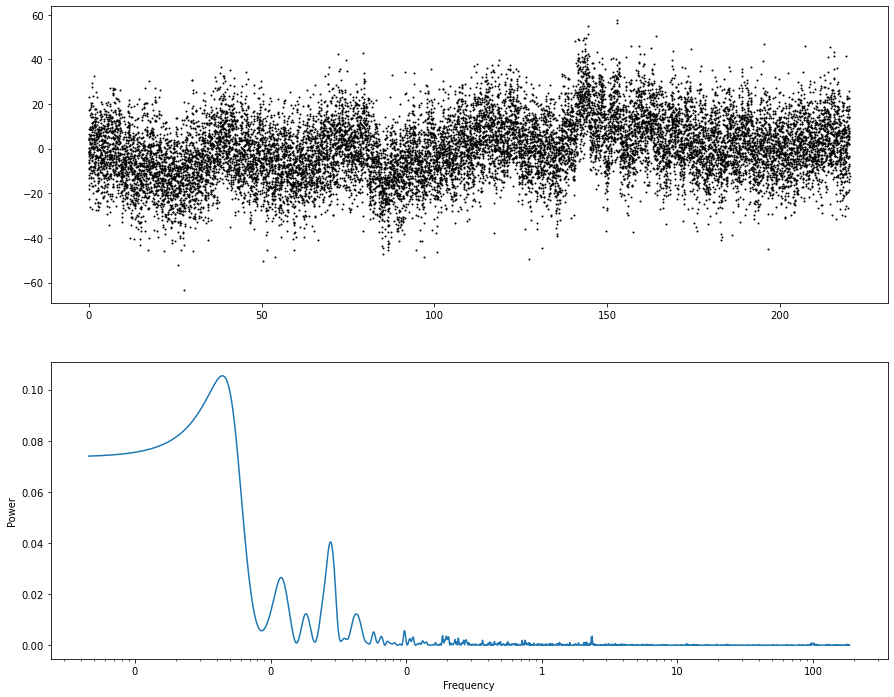

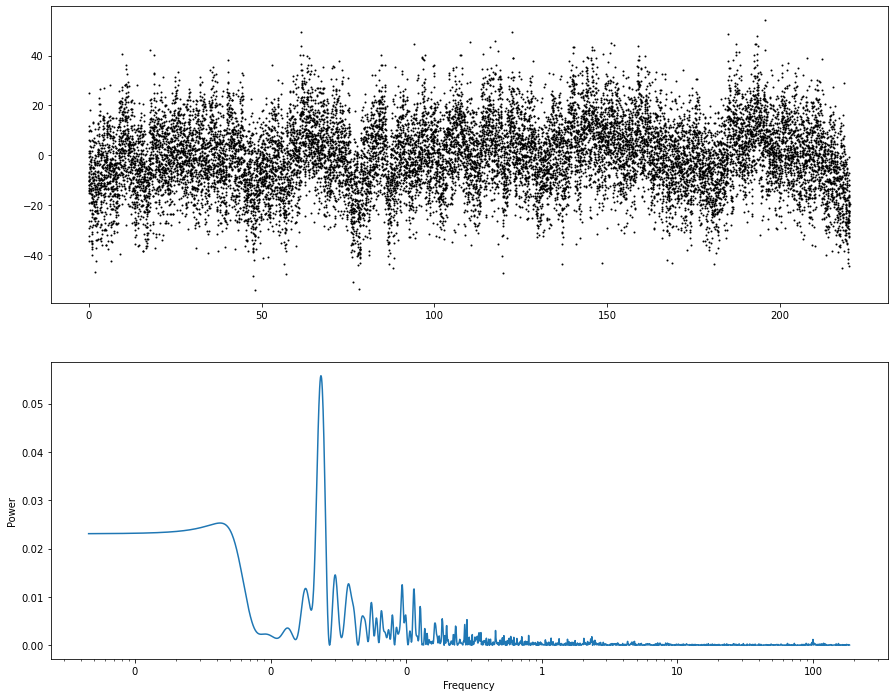

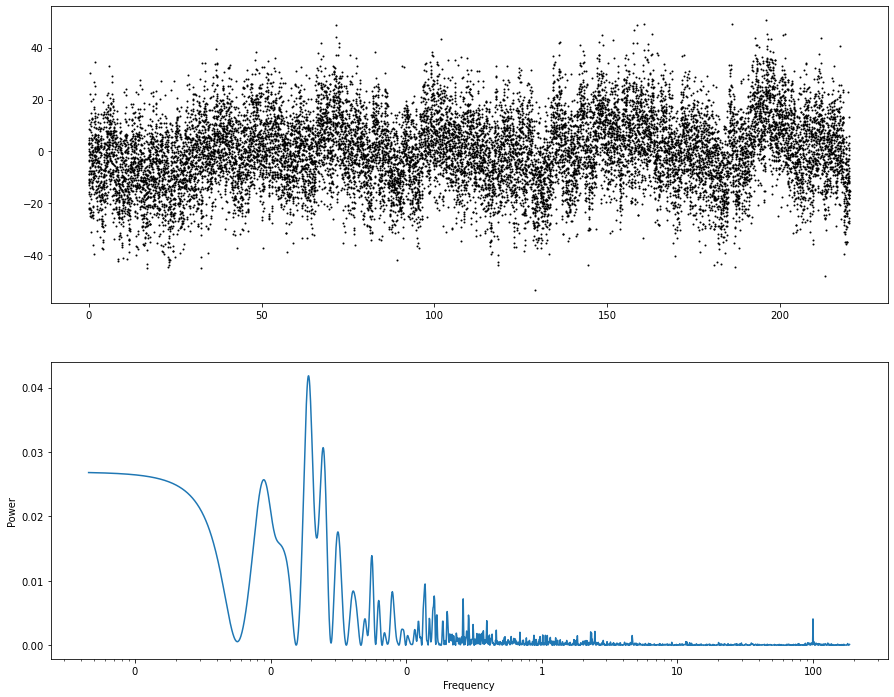

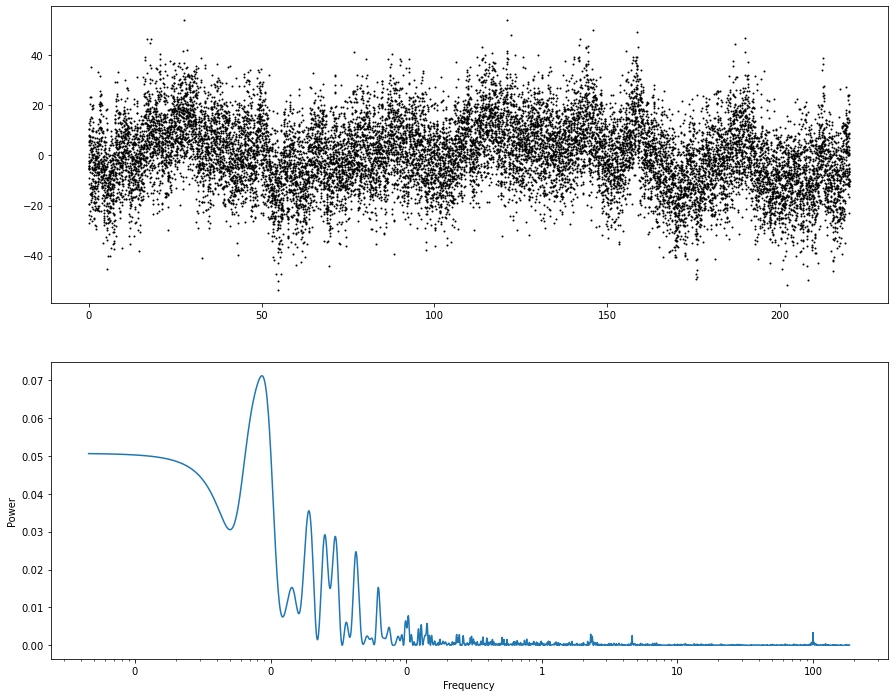

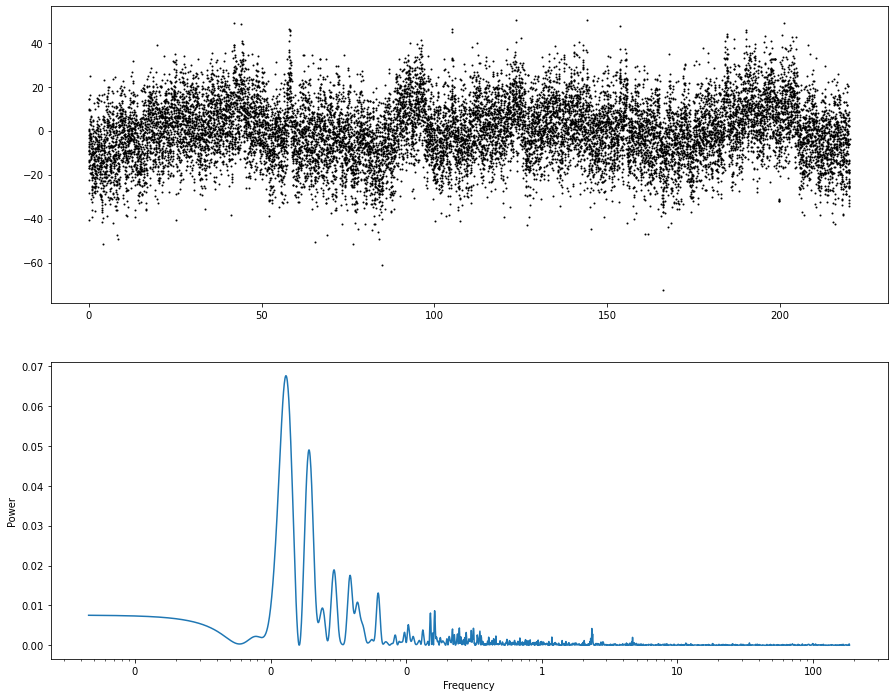

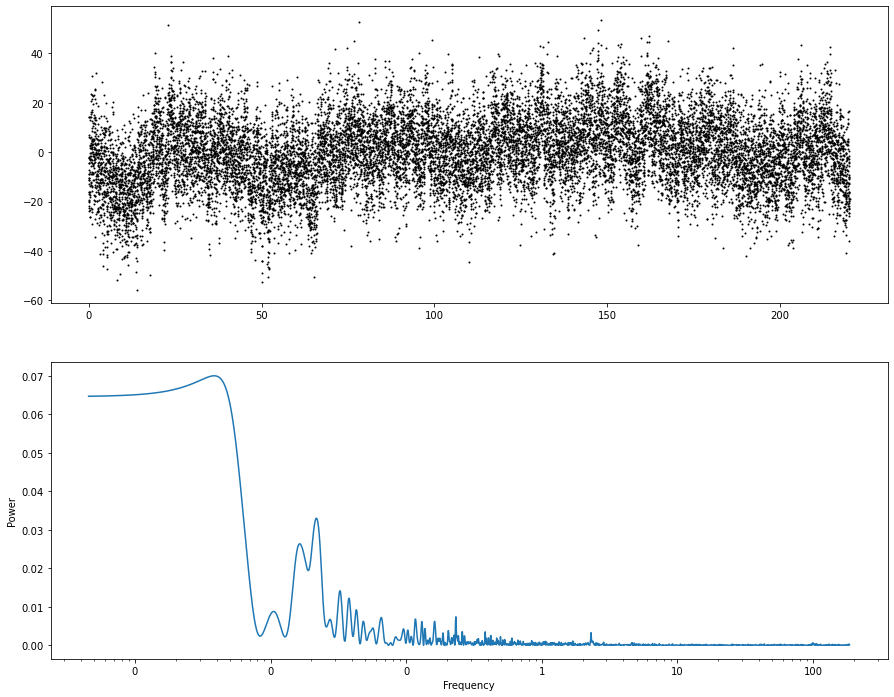

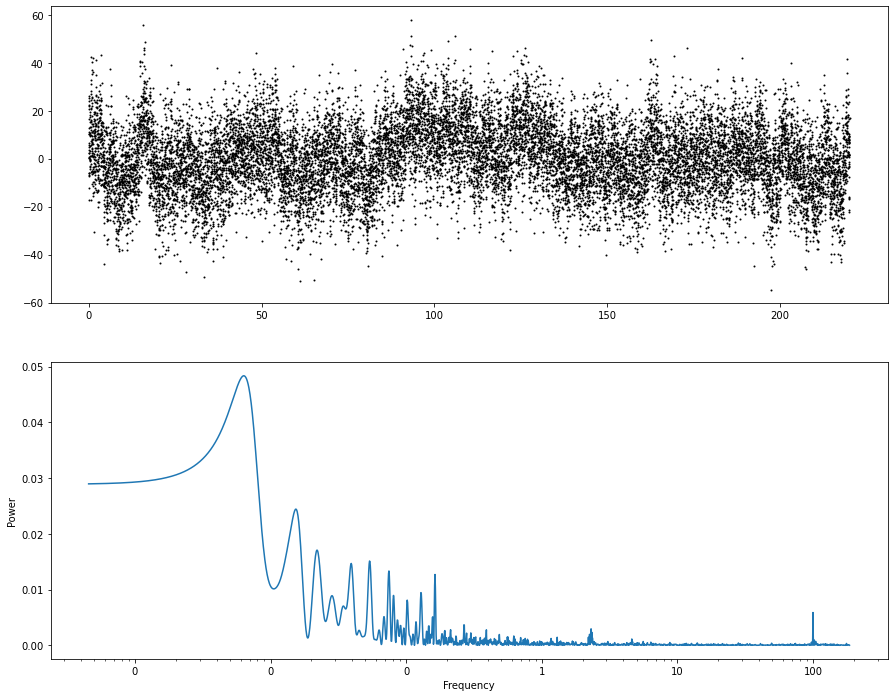

In [116]:
from matplotlib.ticker import ScalarFormatter

frequency_list = []
power_list = []

for num in range(0, len(all_masked_times)):
    x = all_masked_times[num]
    y = all_masked_cols[num]

    # plot with labels and synthetic planet of amplitude 0.78 m/s and 1 year period
    fig, axes = plt.subplots(2,1,figsize=(15, 12))
    ax = axes[0]
    ax.plot(x, y,".", color='k')

    frequency, power = LombScargle(x, y).autopower()
    min_freq = 0.00045446282494091483#np.min(frequency)
    max_freq = 186.14842755862364#np.max(frequency)
    print("min freq: "+str(min_freq)+" max freq: "+str(max_freq))

    frequency2 = np.geomspace(min_freq, max_freq, 2000)#len(frequency))
    power = LombScargle(x, y).power(frequency2)
    
    frequency_list.append(frequency2)
    power_list.append(power)

    ax = axes[1]
    ax.plot(frequency2, power)
    #plt.xlim(0,100)
    ax.set_xscale('log')
    ax.set_xscale('log')
    for axis in [ax.xaxis, ax.yaxis]:
        axis.set_major_formatter(ScalarFormatter())
    #plt.ylim(-0.005, 0.03)
    ax.set_xlabel("Frequency")
    ax.set_ylabel("Power")

    best_frequency = frequency2[np.argmax(power)]
    print("best period: "+str(1/best_frequency))

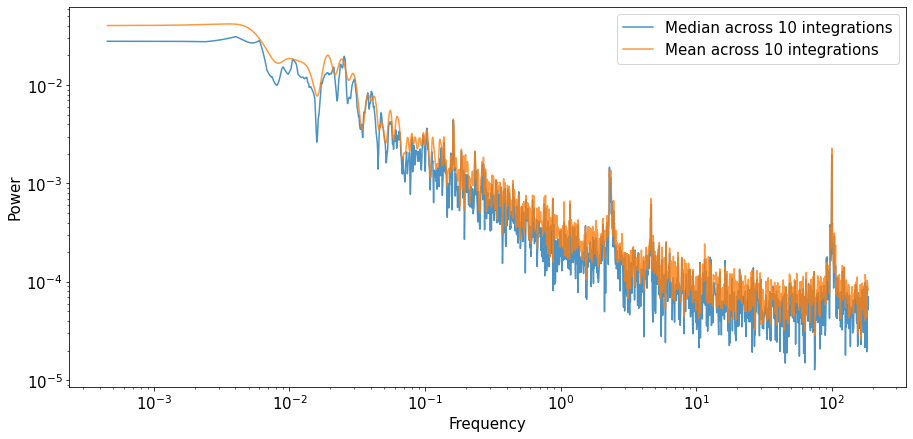

In [117]:
plt.rcParams['font.size'] = 15

med_freq = np.median(frequency_list, axis=0)
med_power = np.median(power_list, axis=0)

mean_freq = np.mean(frequency_list, axis=0)
mean_power = np.mean(power_list, axis=0)


fig, ax = plt.subplots(1,1,figsize=(15, 7))
ax.plot(med_freq, med_power, label="Median across 10 integrations", alpha=0.8)
ax.plot(mean_freq, mean_power, label="Mean across 10 integrations", alpha=0.8)
#ax.plot(mean_freq, (1/(mean_freq**2)), label="1/f")
ax.set_xscale('log')
ax.set_yscale('log')
#for axis in [ax.xaxis, ax.yaxis]:
#    axis.set_major_formatter(ScalarFormatter())
#plt.ylim(-0.005, 0.03)
ax.set_xlabel("Frequency")
ax.set_ylabel("Power")
ax.legend()

In [48]:
import pandas as pd

# write these results to a csv for later visulation purposes
data = {'med_freq': med_freq,
       'mean_freq': mean_freq,
        'med_power': med_power,
       'mean_power': mean_power}

pd_csv = pd.DataFrame(data = data)
#pd_csv.to_csv("ideal1overf_original_power_spectrum.csv")


In [266]:
# Do periodogram again for the new way to mask pixels

time_mask_arrays, col_corr_arrays, col_values_list, image = median_sig_cleanup(integr_nums=10, 
                                                                                           group_nums=3,
                                                                                           rowsize=512)

In [269]:
print(len(time_mask_arrays))
#len(col_corr_arrays[0])


15360


0
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 82.74326886535441
1
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 139.75123990251478
2
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 21.617015521445595
3
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 113.90090732955242
4
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 169.29041725663862
5
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 39.92833426124831
6
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 154.7996280242295
7
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 250.0124735884256
8
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 17.84510175513471
9
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 23.640583793237322
10
min freq: 4.544628249409198e-07 max freq: 

2022-03-23 14:13:09,764 - stpipe - WARNING - /var/folders/rn/06tzsshx6h542jl02_xd33t80000gn/T/ipykernel_25996/2144223004.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(2,1,figsize=(15, 12))



min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 109.61546803031997
21
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 160.85155136462947
22
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 1999232.409149959
23
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 23.944731825263457
24
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 1924012.7350021352
25
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 85.43033810006953
26
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 31.519059899961363
27
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 39.16999553243077
28
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 16.52754492880117
29
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 199.89665200467581
30
min freq: 4.544628249409198e-07 ma

min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 20.539440677416405
189
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2117611.540670631
190
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 278.7095243941854
191
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 131.09821178386355
192
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2037937.937275699
193
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 1887470.9308250863
194
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 11.628786202550986
195
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 228.61210067333613
196
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2144855.681015217
197
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 1911754.1961681873
198
min freq: 4.544628249409

min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 33.814895345476664
357
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 224.2701862653218
358
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 21.895129327205673
359
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 113.90090732955242
360
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 46.548164145788775
361
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2037937.937275699
362
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 7.063418706975374
363
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 52.223813348512984
364
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 111.73764480248808
365
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2131190.076739001
366
min freq: 4.544628249409

min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 17.394640918830756
525
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 137.09701503741178
526
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 85.43033810006953
527
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2172450.3309640675
528
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 36.980306836585605
529
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 141.5492100779265
530
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 50.905536604633745
531
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 1936349.87796555
532
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 47.753600064090854
533
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 16.110342952996458
534
min freq: 4.544628249409

min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 18.901751116160753
693
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 74.69962664064342
694
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 16.110342952996458
695
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 25.362554258011723
696
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2144855.681015217
697
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 1999232.409149959
698
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 19.022952811729933
699
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2024953.542271036
700
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 21.479286170998588
701
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 20.278546944860057
702
min freq: 4.544628249409

min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 87.64268739350183
861
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 1736975.525953402
862
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 250.0124735884256
863
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 101.52223269006565
864
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 88.20466930994182
865
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 17.173692701833744
866
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 1961261.9956123966
867
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 231.55331063351682
868
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 8.393903775927267
869
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 32.54263435291353
870
min freq: 4.54462824940919

min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2158608.911797517
1029
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 35.58894952494757
1030
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 282.29526297377527
1031
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 16.110342952996458
1032
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2200400.0
1033
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2200400.0
1034
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 9.661255565998228
1035
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 82.74326886535441
1036
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 285.92713388841554
1037
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 43.111375033284574
1038
min freq: 4.544628249409198e-07 

min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 8.556411384946093
1195
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 122.1974028834652
1196
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2117611.540670631
1197
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 302.8575345927029
1198
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 27.03658849668773
1199
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 37.217431739125935
1200
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 26.8643292054707
1201
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 51.23195278228966
1202
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 304.79951586644574
1203
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 22.89700853865851
1204
min freq: 4.5446282

2022-03-23 14:13:45,071 - stpipe - WARNING - /Users/zdebeurs/opt/anaconda3/envs/ers-transit/lib/python3.9/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:125: RuntimeWarning: invalid value encountered in true_divide
  power /= YY



min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2200400.0
1261
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 49.62053689400867
1262
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2158608.911797517
1263
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 6.6685581029224545
1264
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 37.69625276653906
1265
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 26.523096197760555
1266
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2144855.681015217
1267
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 43.111375033284574
1268
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 45.664098324356125
1269
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 133.636298651709
1270
min freq: 4.5446282494091

min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 36.744692737364424
1427
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 106.84846361205851
1428
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 27.03658849668773
1429
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 23.489961601806616
1430
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 28.63748684691037
1431
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 137.97610769808045
1432
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2172450.3309640675
1433
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 30.920434280829074
1434
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 16.317610639246304
1435
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 80.65459475169263
1436
min freq: 4.5

2022-03-23 14:13:49,713 - stpipe - WARNING - /Users/zdebeurs/opt/anaconda3/envs/ers-transit/lib/python3.9/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:125: RuntimeWarning: invalid value encountered in true_divide
  power /= YY



min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2200400.0
1482
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 22.606168777447618
1483
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 233.038075388431
1484
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2144855.681015217
1485
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 76.63408774536835
1486
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 192.3756849784231
1487
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 100.23268860559153
1488
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 26.8643292054707
1489
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 12.475822238424902
1490
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 122.1974028834652
1491
min freq: 4.544628249409198

2022-03-23 14:13:50,173 - stpipe - WARNING - /Users/zdebeurs/opt/anaconda3/envs/ers-transit/lib/python3.9/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:125: RuntimeWarning: invalid value encountered in true_divide
  power /= YY



min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2200400.0
1503
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 47.753600064090854
1504
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 21.071340914273165
1505
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2158608.911797517
1506
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 22.035525144654247
1507
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 33.172666080824506
1508
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2200400.0
1509
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 100.87540005257851
1510
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2158608.911797517
1511
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 49.304387594468885
1512
min freq: 4.544628249409198e-0

min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 54.26551408747786
1669
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 91.06909630818681
1670
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 1973837.9880621284
1671
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2131190.076739001
1672
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 100.23268860559153
1673
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 73.75078559278205
1674
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 227.15553530709315
1675
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 57.112483184512364
1676
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 225.70825021367884
1677
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 181.62146208340206
1678
min freq: 4.54

best period: 119.11279484634834
1835
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 26.8643292054707
1836
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 38.920430182563585
1837
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 33.385375652061455
1838
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 45.084069041048494
1839
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 248.419559175387
1840
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 291.46273878956646
1841
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 2037937.937275699
1842
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 100.87540005257851
1843
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 14.544223598415861
1844
min freq: 4.544628249409198e-07 max freq: 0.16088029449191055
best period: 20

KeyboardInterrupt: 

Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x7fd2b28fc1f0> (for post_execute):


KeyboardInterrupt: 

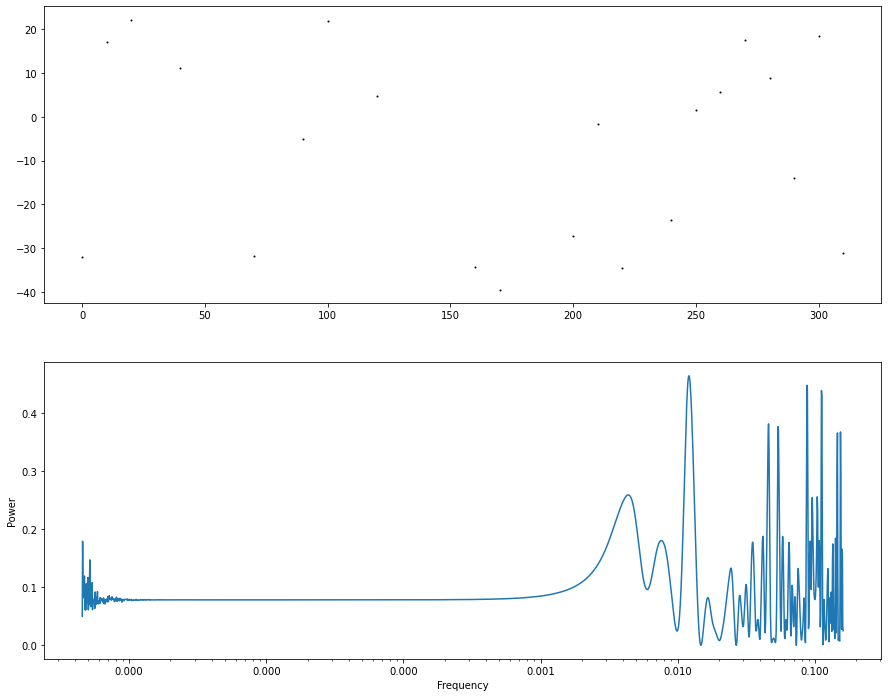

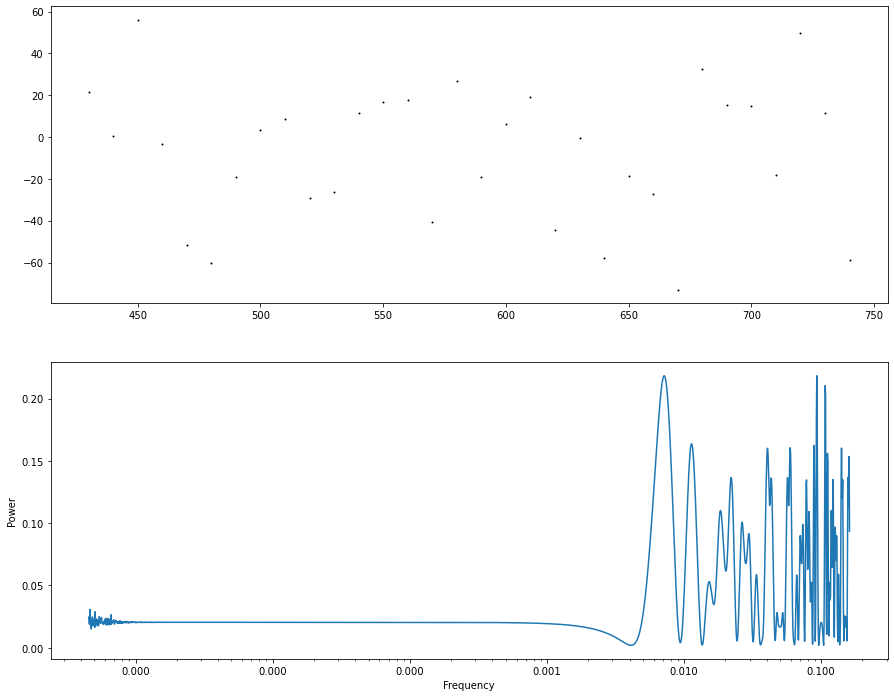

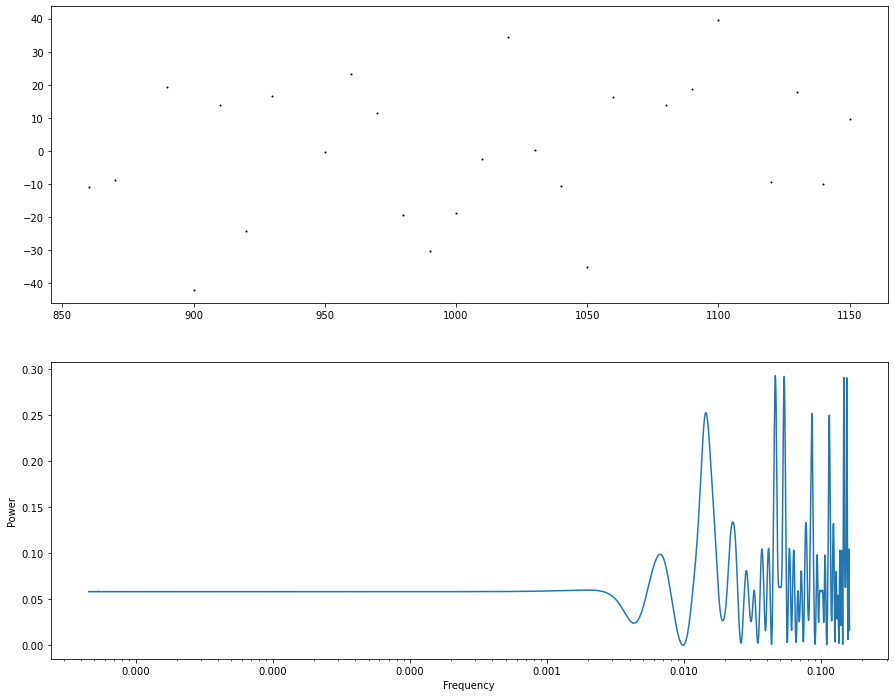

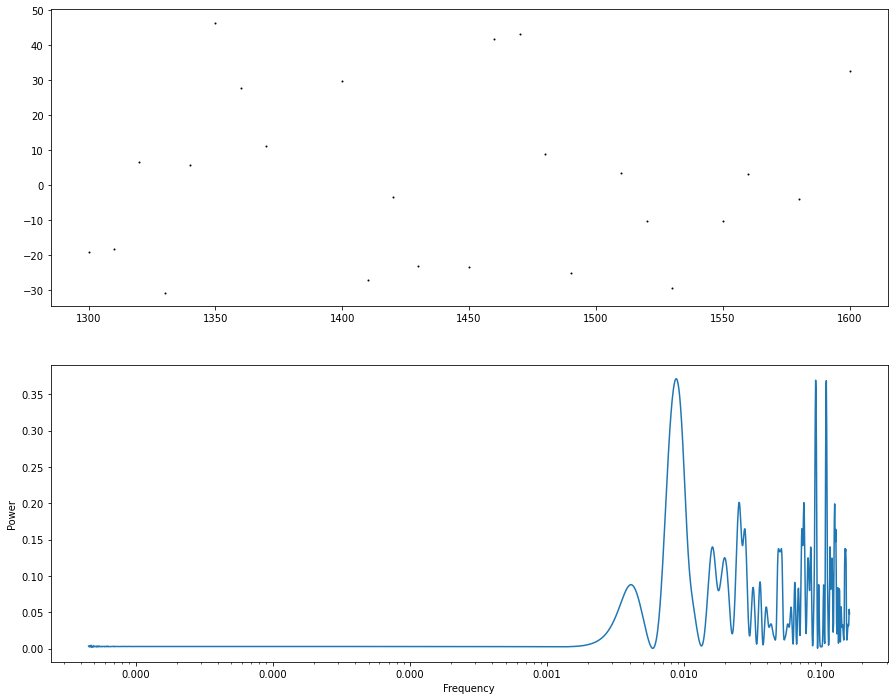

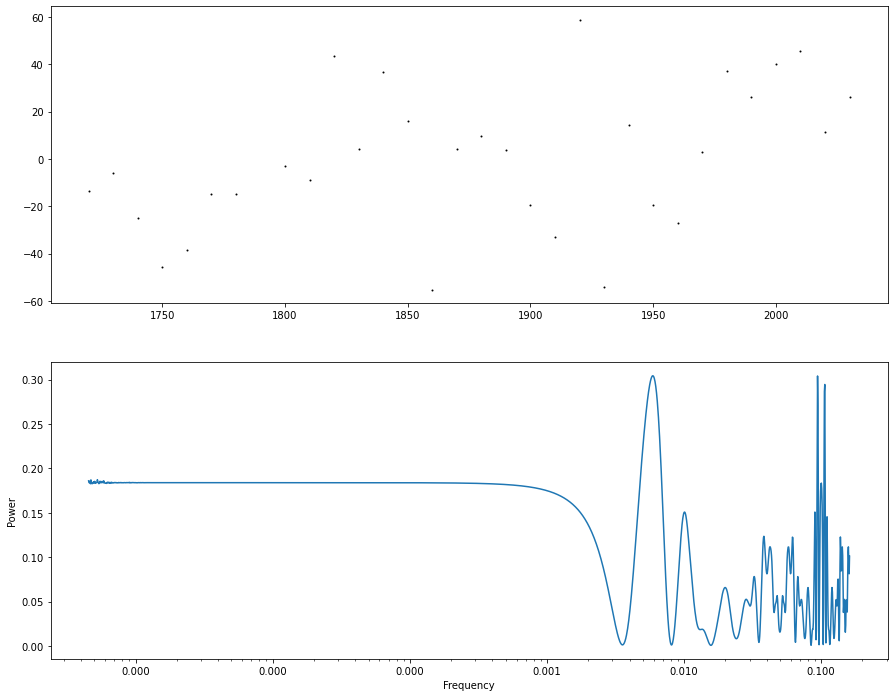

...

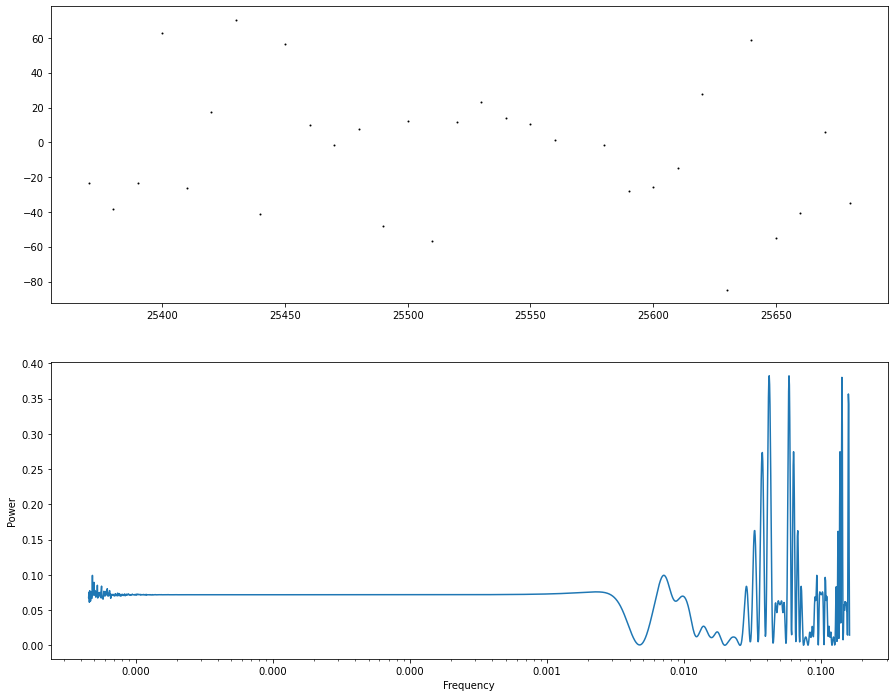

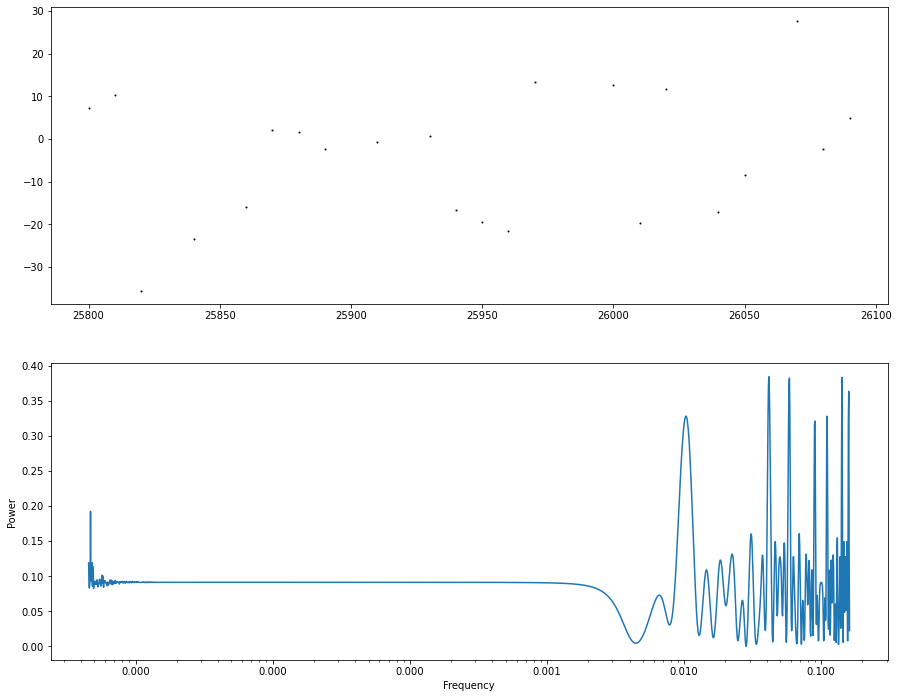

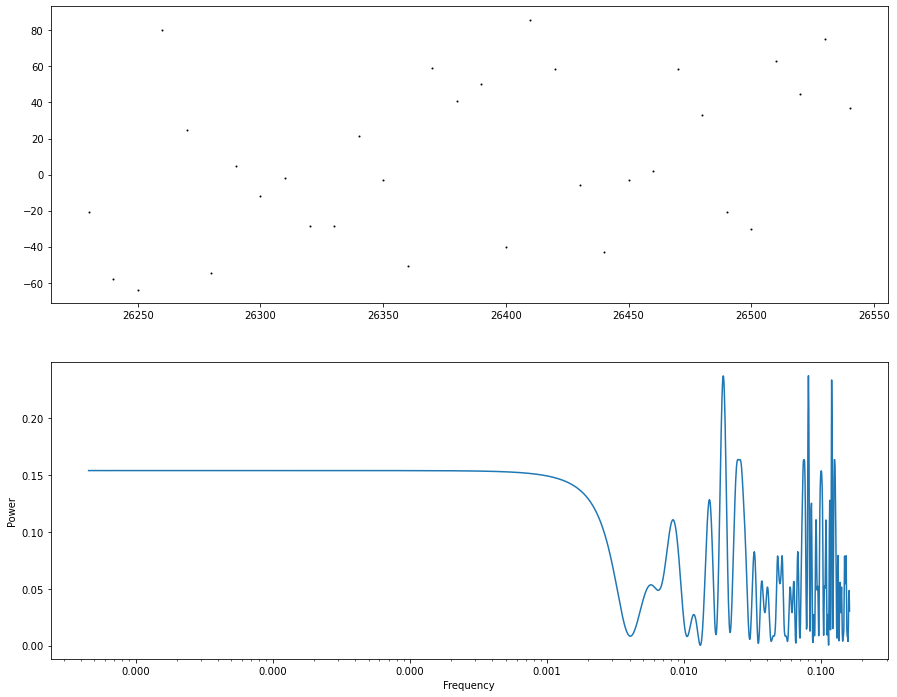

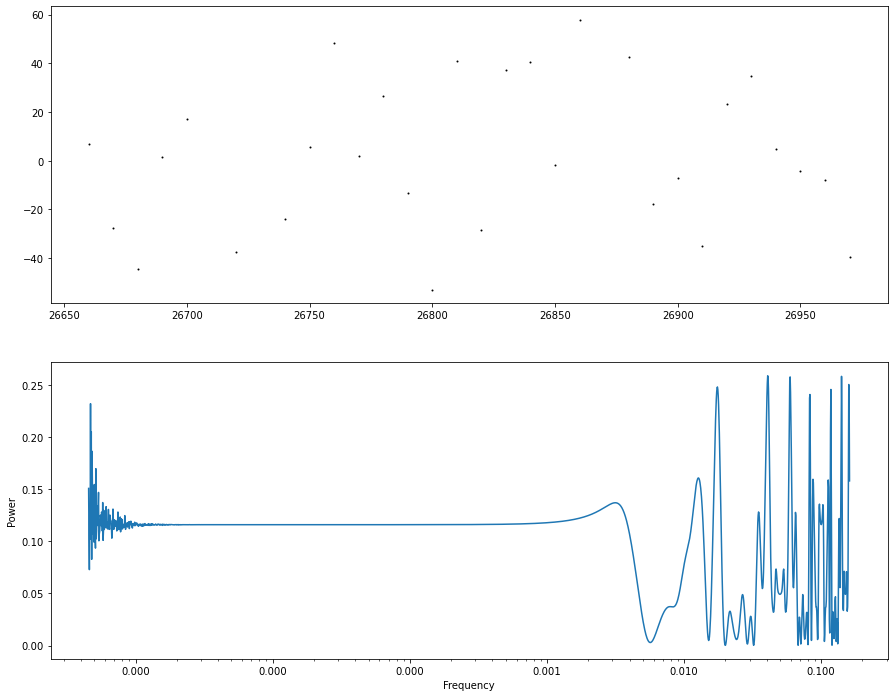

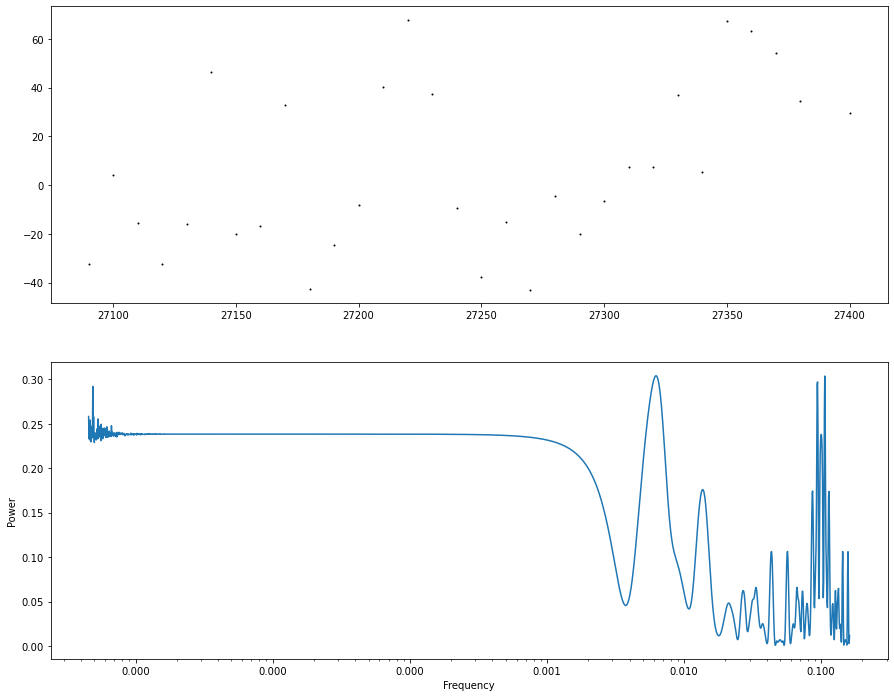

Error in callback <function flush_figures at 0x7fd2b290d940> (for post_execute):


KeyboardInterrupt: 

In [268]:
%matplotlib inline

frequency_list = []
power_list = []

for num in range(0, len(time_mask_arrays)):
    print(num)
    x = time_mask_arrays[num]
    y = col_corr_arrays[num]

    # plot with labels and synthetic planet of amplitude 0.78 m/s and 1 year period
    fig, axes = plt.subplots(2,1,figsize=(15, 12))
    ax = axes[0]
    ax.plot(x, y,".", color='k')

    frequency, power = LombScargle(x, y).autopower()
    min_freq = 4.544628249409198e-07 #np.min(frequency)
    max_freq = 0.16088029449191055 #np.max(frequency)
    print("min freq: "+str(min_freq)+" max freq: "+str(max_freq))

    frequency2 = np.geomspace(min_freq, max_freq, 2000)#len(frequency))
    power = LombScargle(x, y).power(frequency2)
    
    frequency_list.append(frequency2)
    power_list.append(power)

    ax = axes[1]
    ax.plot(frequency2, power)
    #plt.xlim(0,100)
    ax.set_xscale('log')
    ax.set_xscale('log')
    for axis in [ax.xaxis, ax.yaxis]:
        axis.set_major_formatter(ScalarFormatter())
    #plt.ylim(-0.005, 0.03)
    ax.set_xlabel("Frequency")
    ax.set_ylabel("Power")

    best_frequency = frequency2[np.argmax(power)]
    print("best period: "+str(1/best_frequency))

## Line subtraction

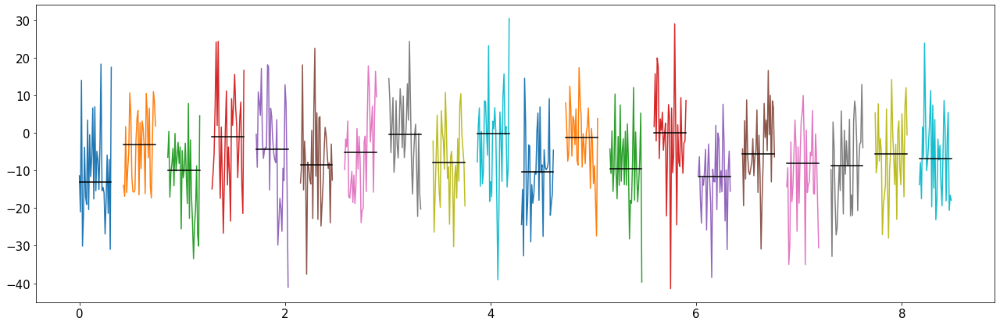

In [121]:


fig, ax = plt.subplots(1,1,figsize=(22, 7))
for number in range(0, 20):#len(col_arrays0)):
    median_col = np.median(col_arrays0[number])
    mean_col = np.mean(col_arrays0[number])
    plt.plot(time_full[number], col_arrays0[number])
    plt.plot(time_full[number], [median_col]*len(time_full[number]), color='k')
    
#fig, ax = plt.subplots(1,1,figsize=(22, 7))
#for number in range(15, 30):#len(col_arrays0)):
#    plt.plot(time_full[number], col_arrays0[number])

In [50]:
np.shape(np.transpose(time_full[number]).reshape((32, 1)))

(32, 1)

In [51]:
np.shape(np.transpose(time_full[number]))

def LS_fit(time_full, numbers, col_arrays, order):

    a_coeff_list = []
    x_list = []
    
    for number in numbers:
        # perform the L-S fit --------------
        n_cols = len(time_full[number])# + 1
        n_rows = len(col_arrays)  # len(ccf_list_np)<---- unsmoothed
        x = np.zeros((n_cols,order+1))

        if order == 1:
            x[:, 0] = 1
            x[:, 1] = time_full[number]
            
        if order == 2:
            x[:, 0] = 1
            x[:, 1] = time_full[number]
            x[:, 2] = time_full[number]**2
            
        if order == 3:
            x[:, 0] = 1
            x[:, 1] = time_full[number]
            x[:, 2] = time_full[number]**2
            x[:, 3] = time_full[number]**3


        #for i in np.arange(1, 32):
        #    x[:, i] = np.transpose(time_full[number]).reshape((32, 1))[i]  # (for all observations)
        y = col_arrays[number]

        alpha = x.transpose().dot(x)
        beta = x.transpose().dot(y)

        # and finally we can write a_coeff = alpha^-1 * beta
        inv_alpha = np.linalg.inv(alpha)
        a_coeff = inv_alpha.dot(beta)
        a_coeff_list.append(a_coeff.tolist())
        x_list.append(x.tolist())
        
    return a_coeff_list, x_list

In [52]:
def LS_fit_one(time_full, col_arrays, order):

    # perform the L-S fit --------------
    n_cols = len(time_full)# + 1
    n_rows = len(col_arrays)  # len(ccf_list_np)<---- unsmoothed
    x = np.zeros((n_rows,order+1))
    
    if order == 1:
        x[:, 0] = 1
        x[:, 1] = time_full
    
    if order == 2:
        x[:, 0] = 1
        x[:, 1] = time_full
        x[:, 2] = time_full**2
        
    if order == 3:
        x[:, 0] = 1
        x[:, 1] = time_full
        x[:, 2] = time_full**2
        x[:, 3] = time_full**3
    

    #for i in np.arange(1, 32):
    #    x[:, i] = np.transpose(time_full[number]).reshape((32, 1))[i]  # (for all observations)
    y = col_arrays

    alpha = x.transpose().dot(x)
    beta = x.transpose().dot(y)

    # and finally we can write a_coeff = alpha^-1 * beta
    inv_alpha = np.linalg.inv(alpha)
    a_coeff = inv_alpha.dot(beta)
        
    return a_coeff, x

In [69]:
def return_xfull(time_full):
    x = np.zeros((32,2))

    x[:, 0] = 1
    x[:, 1] = time_full
    #x[:, 2] = time_full**2
    
    return x

In [54]:
masked_col_array0 = []
masked_time_full = []
for num in range(0, len(col_arrays0)):
    masked_col_array0.append(np.array(col_arrays0[num])[np.where(np.array(col_arrays0[num])<ymin)])
    masked_time_full.append(np.array(time_full[num])[np.where(np.array(col_arrays0[num])<ymin)])
                    
len(masked_col_array0)

512

In [55]:
masked_time_full[0]

array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
       0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21,
       0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3 , 0.31])

In [32]:
    a_coeff_list = []
    x_list = []
    
    numbers_max = 5
    numbers =np.arange(0, numbers_max)
    
    for number in numbers:
        # perform the L-S fit --------------
        n_cols = len(masked_time_full[number])# + 1
        n_rows = len(masked_col_array0)  # len(ccf_list_np)<---- unsmoothed
        x = np.zeros((n_cols,3))

        x[:, 0] = 1
        x[:, 1] = masked_time_full[number]
        x[:, 2] = masked_time_full[number]**2


        #for i in np.arange(1, 32):
        #    x[:, i] = np.transpose(time_full[number]).reshape((32, 1))[i]  # (for all observations)
        y = masked_col_array0[number]

        alpha = x.transpose().dot(x)
        beta = x.transpose().dot(y)

        # and finally we can write a_coeff = alpha^-1 * beta
        inv_alpha = np.linalg.inv(alpha)
        a_coeff = inv_alpha.dot(beta)
        a_coeff_list.append(a_coeff.tolist())
        x_list.append(x.tolist())

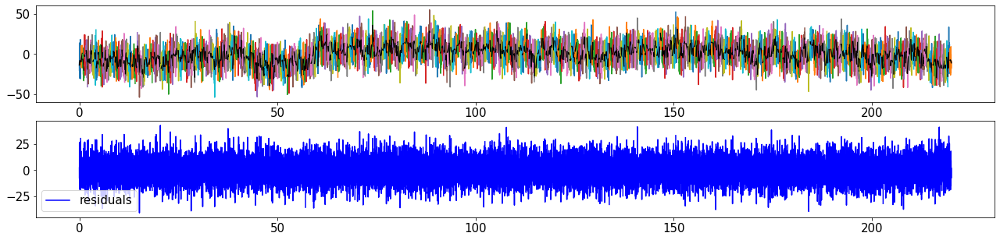

In [57]:
numbers_max = 512

a_coeff_list, x_list = LS_fit(masked_time_full, np.arange(0, numbers_max), masked_col_array0, 2) #time_full, np.arange(0, numbers_max), col_arrays0)#

fig, axes = plt.subplots(2,1,figsize=(22, 5))

ax = axes[0]
for number in range(0, numbers_max):#len(col_arrays0)):
    ax.plot(masked_time_full[number], masked_col_array0[number])
    ax.plot(masked_time_full[number], np.array(x_list[number]).dot(a_coeff_list[number]), color='k')

#ax.set_xlim(42000, 50000)
    
ax = axes[1]
number = 0
ax.plot(masked_time_full[number], masked_col_array0[number]-np.array(x_list[number]).dot(a_coeff_list[number]), 
            label="residuals", color='b')
for number in range(1, numbers_max):#len(col_arrays0)):
    ax.plot(masked_time_full[number], masked_col_array0[number]-np.array(x_list[number]).dot(a_coeff_list[number]), 
            color='b')
    
ax.legend()

In [34]:
masked_time_full[number]

array([3870, 3880, 3890, 3900, 3910, 3920, 3930, 3940, 3950, 3960, 3970,
       3980, 3990, 4000, 4010, 4020, 4030, 4040, 4050, 4060, 4070, 4080,
       4090, 4100, 4110, 4120, 4130, 4140, 4150, 4160, 4170, 4180])

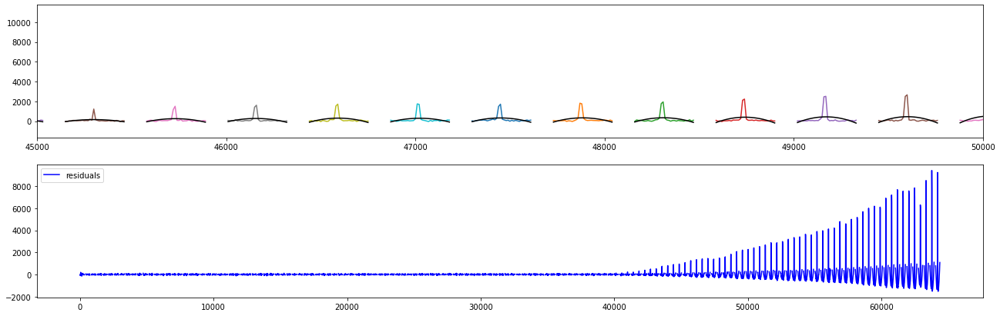

In [85]:
numbers_min = 0
numbers_max = 150#512

a_coeff_list, x_list = LS_fit(time_full, np.arange(numbers_min, numbers_max), col_arrays0, 2)

fig, axes = plt.subplots(2,1,figsize=(22, 7))


ax = axes[0]
for number in range(numbers_min, numbers_max):#len(col_arrays0)):
    ax.plot(time_full[number], col_arrays0[number])
    ax.plot(time_full[number], np.array(x_list[number]).dot(a_coeff_list[number]), color='k')

ax.set_xlim(45000, 50000)
    
ax = axes[1]
number = 0
ax.plot(time_full[number], col_arrays0[number]-np.array(x_list[number]).dot(a_coeff_list[number]), 
            label="residuals", color='b')
for number in range(1, numbers_max):#len(col_arrays0)):
    ax.plot(time_full[number], col_arrays0[number]-np.array(x_list[number]).dot(a_coeff_list[number]), 
            color='b')

ax.legend()

In [337]:
len(col_arrays0)

512

In [338]:
len(col_arrays0[number])

32

## Visualize images before correction

0
1
2
3
4
5
6
7
8
9


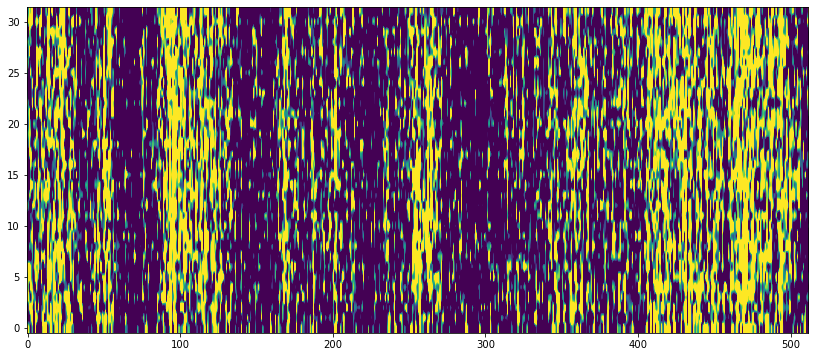

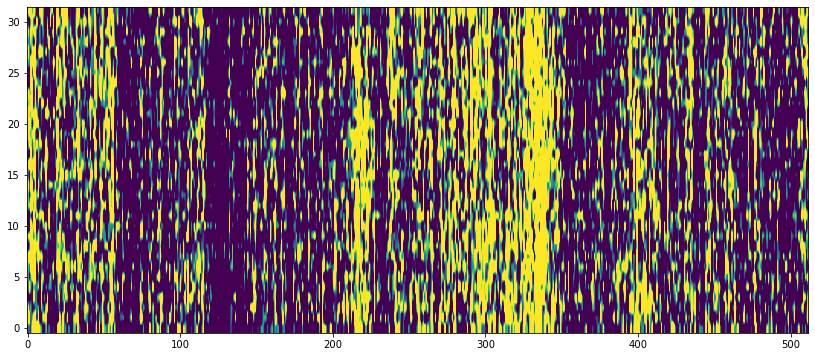

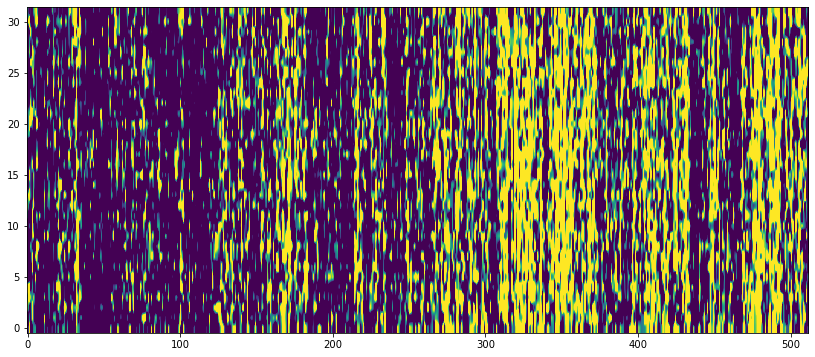

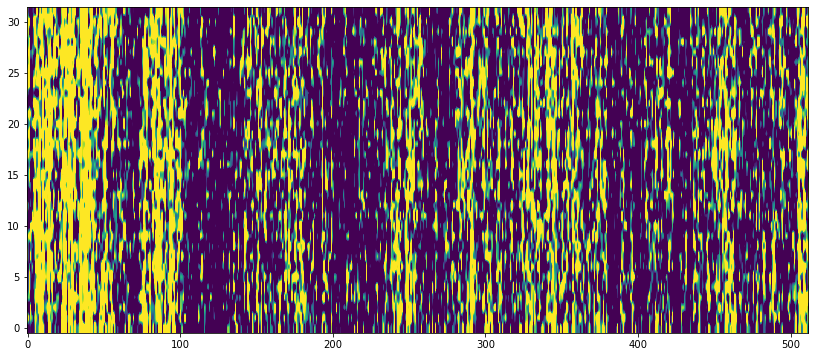

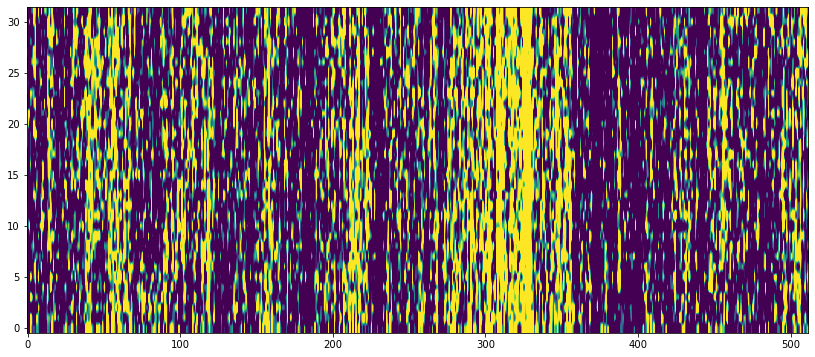

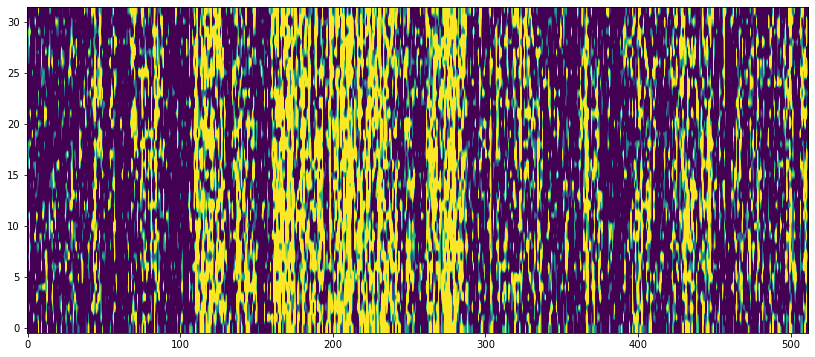

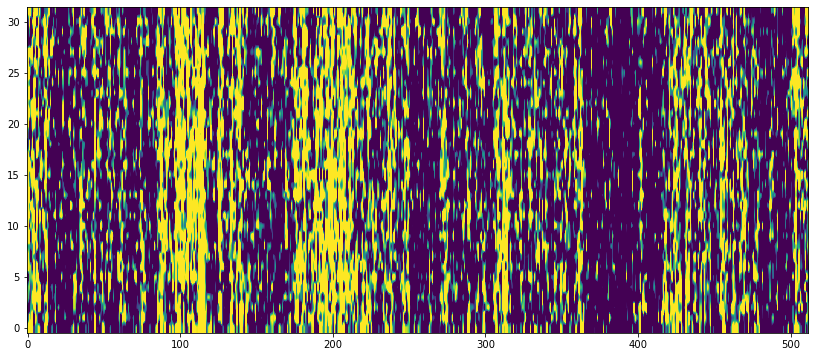

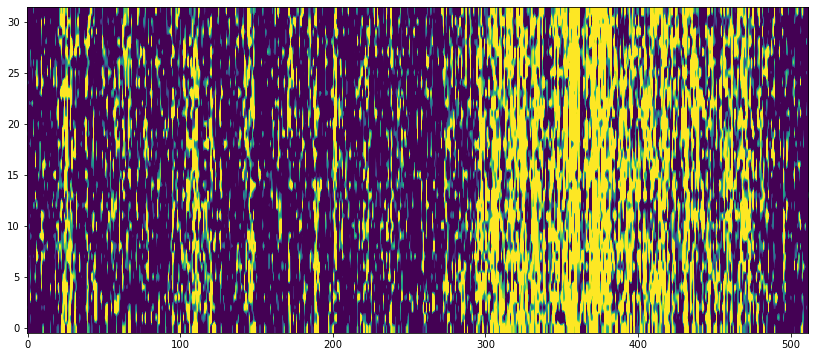

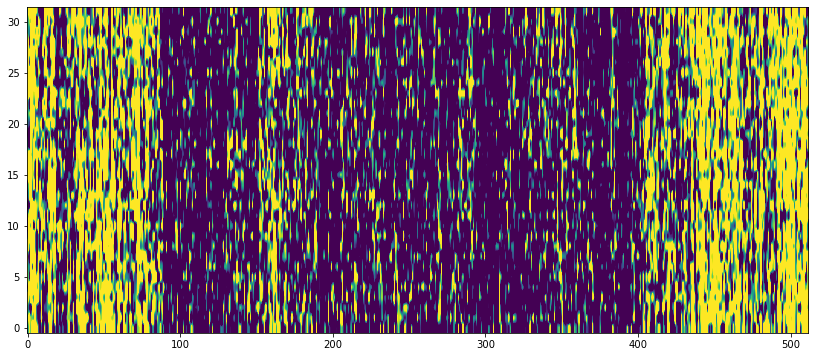

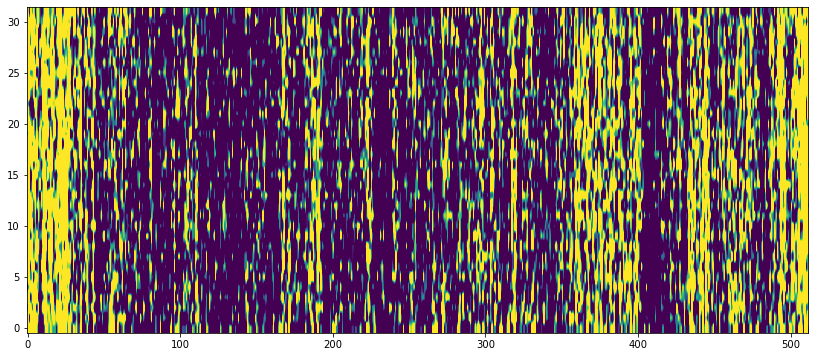

In [58]:
%matplotlib inline
for i in range(0, 10):
    print(i)
    fig, ax = plt.subplots(1, 1, figsize=(14, 6))
    im  = plt.imshow(hdul[1].data[i,1,:,:,], origin = 'lower', aspect='auto',  vmin=0, vmax=10)


In [59]:
np.shape(hdul[1].data[:,:,:,:,])

(10, 5, 32, 512)

## Linear Correction

In [45]:
integr_num = 0
group_num = 0
col_num = 235
col_values= hdul[1].data[integr_num,group_num,:,col_num]
#print(col_values)
col_values[np.where(col_values<ymin)]
print(time_full[col_num][np.where(col_values<ymin)], col_values[np.where(col_values<ymin)])
if len(time_full[col_num][np.where(col_values<ymin)])<2:
    print("too short")
    
    
time_input = time_full[col_num][np.where(col_values<ymin)]
col_input = col_values[np.where(col_values<ymin)]

# perform the L-S fit --------------
n_cols = len(time_input)# + 1
n_rows = len(col_input)  # len(ccf_list_np)<---- unsmoothed
x = np.zeros((n_rows,3))

x[:, 0] = 1
x[:, 1] = time_input
x[:, 2] = time_input[number]**2



#for i in np.arange(1, 32):
#    x[:, i] = np.transpose(time_full[number]).reshape((32, 1))[i]  # (for all observations)
y = col_input

alpha = x.transpose().dot(x)
beta = x.transpose().dot(y)

# and finally we can write a_coeff = alpha^-1 * beta
inv_alpha = np.linalg.pinv(alpha)
a_coeff = inv_alpha.dot(beta)    

#a_coeff, x = LS_fit_one(time_full[col_num][np.where(col_values<ymin)], col_values[np.where(col_values<ymin)])

[101050 101060 101070 101080 101090 101100 101110 101120 101130 101140
 101150 101160 101240 101250 101260 101270 101280 101290 101300 101310
 101320 101330 101340 101350 101360] [ 17.476562   56.24536    16.012207   68.48535    32.41223   -41.496826
  31.852295   35.32544   -42.987793   98.28931    87.73218   142.64526
  94.20557    44.53955    52.645264   81.82568    14.925293   29.772217
  55.93994    41.934326   85.65137    90.87976    48.432617   50.73242
   7.2592773]


In [70]:
# apply linear correction

def lin_corr(integr_nums, group_nums, colsize, rowsize, order):
    col_corr_arrays = []
    col_values_list =[]
    image =  np.zeros((10, 3, 32, 512))
    image_corr = np.zeros((10, 3, 32, 512))
    
    for group_num in range(0, group_nums):
        for integr_num in range(0, integr_nums):
            for col_num in range(0, rowsize):
                    print(integr_num,group_num,col_num)
                    col_values= hdul[1].data[integr_num,group_num,:,col_num]
                    image[integr_num,group_num,:,col_num] = hdul[1].data[integr_num,group_num,:,col_num]
                    col_values_list.append(col_values)
                    
                    if len(time_full[col_num][np.where(col_values<ymin)])<2:
                        print("too short")
                        continue
                    
                    a_coeff, x = LS_fit_one(time_full[col_num][np.where(col_values<ymin)], col_values[np.where(col_values<ymin)], order)
                    col_corr_values = col_values - np.array(return_xfull(time_full[col_num])).dot(a_coeff)
                    col_corr_arrays.append(col_corr_values.tolist())
                    
                    #fig, axes = plt.subplots(2, 1, figsize=(8, 3), gridspec_kw={'height_ratios': [2, 1.5]})
                    
                    #ax = axes[0]
                    #ax.plot(time_full[col_num], hdul[1].data[integr_num,group_num,:,col_num], label="raw")
                    #ax.plot(time_full[col_num], np.array(x).dot(a_coeff), label="lin corr")
                    #ax.legend()
                    
                    #ax = axes[1]
                    #ax.plot(time_full[col_num], col_corr_values, label ="corrected")
                    #ax.set_ylabel("Residuals")
                    #ax.legend()
                    
                    image_corr[integr_num,group_num,:,col_num] = col_corr_values
                    #print(image_corr)
                    
    
    #col_arrays_flat = [item for sublist in col_arrays for item in sublist]
    
    return col_corr_arrays, col_values_list, image, image_corr

In [71]:
time_full[0]

array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
       0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21,
       0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3 , 0.31])

In [72]:
col_corr_arrays, col_values_list,image, image_corr = lin_corr(integr_nums=10, group_nums=3, colsize=1, rowsize=512, order=1)



0 0 0
0 0 1
0 0 2
0 0 3
0 0 4
0 0 5
0 0 6
0 0 7
0 0 8
0 0 9
0 0 10
0 0 11
0 0 12
0 0 13
0 0 14
0 0 15
0 0 16
0 0 17
0 0 18
0 0 19
0 0 20
0 0 21
0 0 22
0 0 23
0 0 24
0 0 25
0 0 26
0 0 27
0 0 28
0 0 29
0 0 30
0 0 31
0 0 32
0 0 33
0 0 34
0 0 35
0 0 36
0 0 37
0 0 38
0 0 39
0 0 40
0 0 41
0 0 42
0 0 43
0 0 44
0 0 45
0 0 46
0 0 47
0 0 48
0 0 49
0 0 50
0 0 51
0 0 52
0 0 53
0 0 54
0 0 55
0 0 56
0 0 57
0 0 58
0 0 59
0 0 60
0 0 61
0 0 62
0 0 63
0 0 64
0 0 65
0 0 66
0 0 67
0 0 68
0 0 69
0 0 70
0 0 71
0 0 72
0 0 73
0 0 74
0 0 75
0 0 76
0 0 77
0 0 78
0 0 79
0 0 80
0 0 81
0 0 82
0 0 83
0 0 84
0 0 85
0 0 86
0 0 87
0 0 88
0 0 89
0 0 90
0 0 91
0 0 92
0 0 93
0 0 94
0 0 95
0 0 96
0 0 97
0 0 98
0 0 99
0 0 100
0 0 101
0 0 102
0 0 103
0 0 104
0 0 105
0 0 106
0 0 107
0 0 108
0 0 109
0 0 110
0 0 111
0 0 112
0 0 113
0 0 114
0 0 115
0 0 116
0 0 117
0 0 118
0 0 119
0 0 120
0 0 121
0 0 122
0 0 123
0 0 124
0 0 125
0 0 126
0 0 127
0 0 128
0 0 129
0 0 130
0 0 131
0 0 132
0 0 133
0 0 134
0 0 135
0 0 136
0 0 137
0 0 13

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1 0 477
1 0 478
1 0 479
1 0 480
1 0 481
1 0 482
1 0 483
1 0 484
1 0 485
1 0 486
1 0 487
1 0 488
1 0 489
1 0 490
1 0 491
1 0 492
1 0 493
1 0 494
1 0 495
1 0 496
1 0 497
1 0 498
1 0 499
1 0 500
1 0 501
1 0 502
1 0 503
1 0 504
1 0 505
1 0 506
1 0 507
1 0 508
1 0 509
1 0 510
1 0 511
2 0 0
2 0 1
2 0 2
2 0 3
2 0 4
2 0 5
2 0 6
2 0 7
2 0 8
2 0 9
2 0 10
2 0 11
2 0 12
2 0 13
2 0 14
2 0 15
2 0 16
2 0 17
2 0 18
2 0 19
2 0 20
2 0 21
2 0 22
2 0 23
2 0 24
2 0 25
2 0 26
2 0 27
2 0 28
2 0 29
2 0 30
2 0 31
2 0 32
2 0 33
2 0 34
2 0 35
2 0 36
2 0 37
2 0 38
2 0 39
2 0 40
2 0 41
2 0 42
2 0 43
2 0 44
2 0 45
2 0 46
2 0 47
2 0 48
2 0 49
2 0 50
2 0 51
2 0 52
2 0 53
2 0 54
2 0 55
2 0 56
2 0 57
2 0 58
2 0 59
2 0 60
2 0 61
2 0 62
2 0 63
2 0 64
2 0 65
2 0 66
2 0 67
2 0 68
2 0 69
2 0 70
2 0 71
2 0 72
2 0 73
2 0 74
2 0 75
2 0 76
2 0 77
2 0 78
2 0 79
2 0 80
2 0 81
2 0 82
2 0 83
2 0 84
2 0 85
2 0 86
2 0 87
2 0 88
2 0 89
2 0 90
2 0 91
2 0 92
2 0 93
2 0 94
2 0 95
2 0 96
2 0 97
2 0 98
2 0 99
2 0 100
2 0 101
2 0 102
2 0 10

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



487
3 0 488
3 0 489
3 0 490
3 0 491
3 0 492
3 0 493
3 0 494
3 0 495
3 0 496
3 0 497
3 0 498
3 0 499
3 0 500
3 0 501
3 0 502
3 0 503
3 0 504
3 0 505
3 0 506
3 0 507
3 0 508
3 0 509
3 0 510
3 0 511
4 0 0
4 0 1
4 0 2
4 0 3
4 0 4
4 0 5
4 0 6
4 0 7
4 0 8
4 0 9
4 0 10
4 0 11
4 0 12
4 0 13
4 0 14
4 0 15
4 0 16
4 0 17
4 0 18
4 0 19
4 0 20
4 0 21
4 0 22
4 0 23
4 0 24
4 0 25
4 0 26
4 0 27
4 0 28
4 0 29
4 0 30
4 0 31
4 0 32
4 0 33
4 0 34
4 0 35
4 0 36
4 0 37
4 0 38
4 0 39
4 0 40
4 0 41
4 0 42
4 0 43
4 0 44
4 0 45
4 0 46
4 0 47
4 0 48
4 0 49
4 0 50
4 0 51
4 0 52
4 0 53
4 0 54
4 0 55
4 0 56
4 0 57
4 0 58
4 0 59
4 0 60
4 0 61
4 0 62
4 0 63
4 0 64
4 0 65
4 0 66
4 0 67
4 0 68
4 0 69
4 0 70
4 0 71
4 0 72
4 0 73
4 0 74
4 0 75
4 0 76
4 0 77
4 0 78
4 0 79
4 0 80
4 0 81
4 0 82
4 0 83
4 0 84
4 0 85
4 0 86
4 0 87
4 0 88
4 0 89
4 0 90
4 0 91
4 0 92
4 0 93
4 0 94
4 0 95
4 0 96
4 0 97
4 0 98
4 0 99
4 0 100
4 0 101
4 0 102
4 0 103
4 0 104
4 0 105
4 0 106
4 0 107
4 0 108
4 0 109
4 0 110
4 0 111
4 0 112
4 0 113
4 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




5 0 506
5 0 507
5 0 508
5 0 509
5 0 510
5 0 511
6 0 0
6 0 1
6 0 2
6 0 3
6 0 4
6 0 5
6 0 6
6 0 7
6 0 8
6 0 9
6 0 10
6 0 11
6 0 12
6 0 13
6 0 14
6 0 15
6 0 16
6 0 17
6 0 18
6 0 19
6 0 20
6 0 21
6 0 22
6 0 23
6 0 24
6 0 25
6 0 26
6 0 27
6 0 28
6 0 29
6 0 30
6 0 31
6 0 32
6 0 33
6 0 34
6 0 35
6 0 36
6 0 37
6 0 38
6 0 39
6 0 40
6 0 41
6 0 42
6 0 43
6 0 44
6 0 45
6 0 46
6 0 47
6 0 48
6 0 49
6 0 50
6 0 51
6 0 52
6 0 53
6 0 54
6 0 55
6 0 56
6 0 57
6 0 58
6 0 59
6 0 60
6 0 61
6 0 62
6 0 63
6 0 64
6 0 65
6 0 66
6 0 67
6 0 68
6 0 69
6 0 70
6 0 71
6 0 72
6 0 73
6 0 74
6 0 75
6 0 76
6 0 77
6 0 78
6 0 79
6 0 80
6 0 81
6 0 82
6 0 83
6 0 84
6 0 85
6 0 86
6 0 87
6 0 88
6 0 89
6 0 90
6 0 91
6 0 92
6 0 93
6 0 94
6 0 95
6 0 96
6 0 97
6 0 98
6 0 99
6 0 100
6 0 101
6 0 102
6 0 103
6 0 104
6 0 105
6 0 106
6 0 107
6 0 108
6 0 109
6 0 110
6 0 111
6 0 112
6 0 113
6 0 114
6 0 115
6 0 116
6 0 117
6 0 118
6 0 119
6 0 120
6 0 121
6 0 122
6 0 123
6 0 124
6 0 125
6 0 126
6 0 127
6 0 128
6 0 129
6 0 130
6 0 131
6 0 1

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 0 26
8 0 27
8 0 28
8 0 29
8 0 30
8 0 31
8 0 32
8 0 33
8 0 34
8 0 35
8 0 36
8 0 37
8 0 38
8 0 39
8 0 40
8 0 41
8 0 42
8 0 43
8 0 44
8 0 45
8 0 46
8 0 47
8 0 48
8 0 49
8 0 50
8 0 51
8 0 52
8 0 53
8 0 54
8 0 55
8 0 56
8 0 57
8 0 58
8 0 59
8 0 60
8 0 61
8 0 62
8 0 63
8 0 64
8 0 65
8 0 66
8 0 67
8 0 68
8 0 69
8 0 70
8 0 71
8 0 72
8 0 73
8 0 74
8 0 75
8 0 76
8 0 77
8 0 78
8 0 79
8 0 80
8 0 81
8 0 82
8 0 83
8 0 84
8 0 85
8 0 86
8 0 87
8 0 88
8 0 89
8 0 90
8 0 91
8 0 92
8 0 93
8 0 94
8 0 95
8 0 96
8 0 97
8 0 98
8 0 99
8 0 100
8 0 101
8 0 102
8 0 103
8 0 104
8 0 105
8 0 106
8 0 107
8 0 108
8 0 109
8 0 110
8 0 111
8 0 112
8 0 113
8 0 114
8 0 115
8 0 116
8 0 117
8 0 118
8 0 119
8 0 120
8 0 121
8 0 122
8 0 123
8 0 124
8 0 125
8 0 126
8 0 127
8 0 128
8 0 129
8 0 130
8 0 131
8 0 132
8 0 133
8 0 134
8 0 135
8 0 136
8 0 137
8 0 138
8 0 139
8 0 140
8 0 141
8 0 142
8 0 143
8 0 144
8 0 145
8 0 146
8 0 147
8 0 148
8 0 149
8 0 150
8 0 151
8 0 152
8 0 153
8 0 154
8 0 155
8 0 156
8 0 157
8 0 158
8 0 159
8 0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1 64
0 1 65
0 1 66
0 1 67
0 1 68
0 1 69
0 1 70
0 1 71
0 1 72
0 1 73
0 1 74
0 1 75
0 1 76
0 1 77
0 1 78
0 1 79
0 1 80
0 1 81
0 1 82
0 1 83
0 1 84
0 1 85
0 1 86
0 1 87
0 1 88
0 1 89 131
0 1 132
0 1 133
0 1 134
0 1 135
0 1 136
0 1 137
0 1 138
0 1 139
0 1 140
0 1 141
0 1 142
0 1 143
0 1 144
0 1 145
0 1 146
0 1 147
0 1 148
0 1 149
0 1 150
0 1 151
0 1 152
0 1 153
0 1 154
0 1 155
0 1 156
0 1 157
0 1 158
0 1 159
0 1 160
0 1 161
0 1 162
0 1 163
0 1 164
0 1 165
0 1 166
0 1 167
0 1 168
0 1 169
0 1 170
0 1 171
0 1 172
0 1 173
0 1 174
0 1 175
0 1 176
0 1 177
0 1 178
0 1 179
0 1 180
0 1 181
0 1 182
0 1 183
0 1 184
0 1 185
0 1 186
0 1 187
0 1 188
0 1 189
0 1 190
0 1 191
0 1 192
0 1 193
0 1 194
0 1 195
0 1 196
0 1 197
0 1 198
0 1 199
0 1 200
0 1 201
0 1 202
0 1 203
0 1 204
0 1 205
0 1 206
0 1 207
0 1 208
0 1 209
0 1 210
0 1 211
0 1 212
0 1 213
0 1 214
0 1 215
0 1 216
0 1 217
0 1 218
0 1 219
0 1 220
0 1 221
0 1 222
0 1 223
0 1 224
0 1 225
0 1 226
0 1 227
0 1 228
0 1 229
0 1 230
0 1 231
0 1 232
0 1 233


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1 347
2 1 348
2 1 349
2 1 350
2 1 351
2 1 352
2 1 353
2 1 354
2 1 355
2 1 356
2 1 357
2 1 358
2 1 359
2 1 360
2 1 361
2 1 362
2 1 363
2 1 364
2 1 365
2 1 366
2 1 367
2 1 368
2 1 369
2 1 370
2 1 371
2 1 372
2 1 373
2 1 374
2 1 375
2 1 376
2 1 377
2 1 378
2 1 379
2 1 380
2 1 381
2 1 382
2 1 383
2 1 384
2 1 385
2 1 386
2 1 387
2 1 388
2 1 389
2 1 390
2 1 391
2 1 392
2 1 393
2 1 394
2 1 395
2 1 396
2 1 397
2 1 398
2 1 399
2 1 400
2 1 401
2 1 402
2 1 403
2 1 404
2 1 405
2 1 406
2 1 407
2 1 408
2 1 409
2 1 410
2 1 411
2 1 412
2 1 413
2 1 414
2 1 415
2 1 416
2 1 417
2 1 418
2 1 419
2 1 420
2 1 421
2 1 422
2 1 423
2 1 424
2 1 425
2 1 426
2 1 427
2 1 428
2 1 429
2 1 430
2 1 431
2 1 432
2 1 433
2 1 434
2 1 435
2 1 436
2 1 437
2 1 438
2 1 439
2 1 440
2 1 441
2 1 442
2 1 443
2 1 444
2 1 445
2 1 446
2 1 447
2 1 448
2 1 449
2 1 450
2 1 451
2 1 452
2 1 453
2 1 454
2 1 455
2 1 456
2 1 457
2 1 458
2 1 459
2 1 460
2 1 461
2 1 462
2 1 463
2 1 464
2 1 465
2 1 466
2 1 467
2 1 468
2 1 469
2 1 470
2 1 471
2 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



137
5 1 138
5 1 139
5 1 140
5 1 141
5 1 142
5 1 143
5 1 144
5 1 145
5 1 146
5 1 147
5 1 148
5 1 149
5 1 150
5 1 151
5 1 152
5 1 153
5 1 154
5 1 155
5 1 156
5 1 157
5 1 158
5 1 159
5 1 160
5 1 161
5 1 162
5 1 163
5 1 164
5 1 165
5 1 166
5 1 167
5 1 168
5 1 169
5 1 170
5 1 171
5 1 172
5 1 173
5 1 174
5 1 175
5 1 176
5 1 177
5 1 178
5 1 179
5 1 180
5 1 181
5 1 182
5 1 183
5 1 184
5 1 185
5 1 186
5 1 187
5 1 188
5 1 189
5 1 190
5 1 191
5 1 192
5 1 193
5 1 194
5 1 195
5 1 196
5 1 197
5 1 198
5 1 199
5 1 200
5 1 201
5 1 202
5 1 203
5 1 204
5 1 205
5 1 206
5 1 207
5 1 208
5 1 209
5 1 210
5 1 211
5 1 212
5 1 213
5 1 214
5 1 215
5 1 216
5 1 217
5 1 218
5 1 219
5 1 220
5 1 221
5 1 222
5 1 223
5 1 224
5 1 225
5 1 226
5 1 227
5 1 228
5 1 229
5 1 230
5 1 231
5 1 232
5 1 233
5 1 234
5 1 235
5 1 236
5 1 237
5 1 238
5 1 239
5 1 240
5 1 241
5 1 242
5 1 243
5 1 244
5 1 245
5 1 246
5 1 247
5 1 248
5 1 249
5 1 250
5 1 251
5 1 252
5 1 253
5 1 254
5 1 255
5 1 256
5 1 257
5 1 258
5 1 259
5 1 260
5 1 261
5 1 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



440
7 1 441
7 1 442
7 1 443
7 1 444
7 1 445
7 1 446
7 1 447
7 1 448
7 1 449
7 1 450
7 1 451
7 1 452
7 1 453
7 1 454
7 1 455
7 1 456
7 1 457
7 1 458
7 1 459
7 1 460
7 1 461
7 1 462
7 1 463
7 1 464
7 1 465
7 1 466
7 1 467
7 1 468
7 1 469
7 1 470
7 1 471
7 1 472
7 1 473
7 1 474
7 1 475
7 1 476
7 1 477
7 1 478
7 1 479
7 1 480
7 1 481
7 1 482
7 1 483
7 1 484
7 1 485
7 1 486
7 1 487
7 1 488
7 1 489
7 1 490
7 1 491
7 1 492
7 1 493
7 1 494
7 1 495
7 1 496
7 1 497
7 1 498
7 1 499
7 1 500
7 1 501
7 1 502
7 1 503
7 1 504
7 1 505
7 1 506
7 1 507
7 1 508
7 1 509
7 1 510
7 1 511
8 1 0
8 1 1
8 1 2
8 1 3
8 1 4
8 1 5
8 1 6
8 1 7
8 1 8
8 1 9
8 1 10
8 1 11
8 1 12
8 1 13
8 1 14
8 1 15
8 1 16
8 1 17
8 1 18
8 1 19
8 1 20
8 1 21
8 1 22
8 1 23
8 1 24
8 1 25
8 1 26
8 1 27
8 1 28
8 1 29
8 1 30
8 1 31
8 1 32
8 1 33
8 1 34
8 1 35
8 1 36
8 1 37
8 1 38
8 1 39
8 1 40
8 1 41
8 1 42
8 1 43
8 1 44
8 1 45
8 1 46
8 1 47
8 1 48
8 1 49
8 1 50
8 1 51
8 1 52
8 1 53
8 1 54
8 1 55
8 1 56
8 1 57
8 1 58
8 1 59
8 1 60
8 1 61
8 1 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 296
0 2 297
0 2 298
0 2 299
0 2 300
0 2 301
0 2 302
0 2 303
0 2 304
0 2 305
0 2 306
0 2 307
0 2 308
0 2 309
0 2 310
0 2 311
0 2 312
0 2 313
0 2 314
0 2 315
0 2 316
0 2 317
0 2 318
0 2 319
0 2 320
0 2 321
0 2 322
0 2 323
0 2 324
0 2 325
0 2 326
0 2 327
0 2 328
0 2 329
0 2 330
0 2 331
0 2 332
0 2 333
0 2 334
0 2 335
0 2 336
0 2 337
0 2 338
0 2 339
0 2 340
0 2 341
0 2 342
0 2 343
0 2 344
0 2 345
0 2 346
0 2 347
0 2 348
0 2 349
0 2 350
0 2 351
0 2 352
0 2 353
0 2 354
0 2 355
0 2 356
0 2 357
0 2 358
0 2 359
0 2 360
0 2 361
0 2 362
0 2 363
0 2 364
0 2 365
0 2 366
0 2 367
0 2 368
0 2 369
0 2 370
0 2 371
0 2 372
0 2 373
0 2 374
0 2 375
0 2 376
0 2 377
0 2 378
0 2 379
0 2 380
0 2 381
0 2 382
0 2 383
0 2 384
0 2 385
0 2 386
0 2 387
0 2 388
0 2 389
0 2 390
0 2 391
0 2 392
0 2 393
0 2 394
0 2 395
0 2 396
0 2 397
0 2 398
0 2 399
0 2 400
0 2 401
0 2 402
0 2 403
0 2 404
0 2 405
0 2 406
0 2 407
0 2 408
0 2 409
0 2 410
0 2 411
0 2 412
0 2 413
0 2 414
0 2 415
0 2 416
0 2 417
0 2 418
0 2 419
0 2 420
0 2

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




3 2 123
3 2 124
3 2 125
3 2 126
3 2 127
3 2 128
3 2 129
3 2 130
3 2 131
3 2 132
3 2 133
3 2 134
3 2 135
3 2 136
3 2 137
3 2 138
3 2 139
3 2 140
3 2 141
3 2 142
3 2 143
3 2 144
3 2 145
3 2 146
3 2 147
3 2 148
3 2 149
3 2 150
3 2 151
3 2 152
3 2 153
3 2 154
3 2 155
3 2 156
3 2 157
3 2 158
3 2 159
3 2 160
3 2 161
3 2 162
3 2 163
3 2 164
3 2 165
3 2 166
3 2 167
3 2 168
3 2 169
3 2 170
3 2 171
3 2 172
3 2 173
3 2 174
3 2 175
3 2 176
3 2 177
3 2 178
3 2 179
3 2 180
3 2 181
3 2 182
3 2 183
3 2 184
3 2 185
3 2 186
3 2 187
3 2 188
3 2 189
3 2 190
3 2 191
3 2 192
3 2 193
3 2 194
3 2 195
3 2 196
3 2 197
3 2 198
3 2 199
3 2 200
3 2 201
3 2 202
3 2 203
3 2 204
3 2 205
3 2 206
3 2 207
3 2 2 392
3 2 393
3 2 394
3 2 395
3 2 396
3 2 397
3 2 398
3 2 399
3 2 400
3 2 401
3 2 402
3 2 403
3 2 404
3 2 405
3 2 406
3 2 407
3 2 408
3 2 409
3 2 410
3 2 411
3 2 412
3 2 413
3 2 414
3 2 415
3 2 416
3 2 417
3 2 418
3 2 419
3 2 420
3 2 421
3 2 422
3 2 423
3 2 424
3 2 425
3 2 426
3 2 427
3 2 428
3 2 429
3 2 430
3 2 4

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 470
5 2 471
5 2 472
5 2 473
5 2 474
5 2 475
5 2 476
5 2 477
5 2 478
5 2 479
5 2 480
5 2 481
5 2 482
5 2 483
5 2 484
5 2 485
5 2 486
5 2 487
5 2 488
5 2 489
5 2 490
5 2 491
5 2 492
5 2 493
5 2 494
5 2 495
5 2 496
5 2 497
5 2 498
5 2 499
5 2 500
5 2 501
5 2 502
5 2 503
5 2 504
5 2 505
5 2 506
5 2 507
5 2 508
5 2 509
5 2 510
5 2 511
6 2 0
6 2 1
6 2 189
6 2 190
6 2 191
6 2 192
6 2 193
6 2 194
6 2 195
6 2 196
6 2 197
6 2 198
6 2 199
6 2 200
6 2 201
6 2 202
6 2 203
6 2 204
6 2 205
6 2 206
6 2 207
6 2 208
6 2 209
6 2 210
6 2 211
6 2 212
6 2 213
6 2 214
6 2 215
6 2 216
6 2 217
6 2 218
6 2 219
6 2 220
6 2 221
6 2 222
6 2 223
6 2 224
6 2 225
6 2 226
6 2 227
6 2 228
6 2 229
6 2 230
6 2 231
6 2 232
6 2 233
6 2 234
6 2 235
6 2 236
6 2 237
6 2 238
6 2 239
6 2 240
6 2 241
6 2 242
6 2 243
6 2 244
6 2 245
6 2 246
6 2 247
6 2 248
6 2 249
6 2 250
6 2 251
6 2 252
6 2 253
6 2 254
6 2 255
6 2 256
6 2 257
6 2 258
6 2 259
6 2 260
6 2 261
6 2 262
6 2 263
6 2 264
6 2 265
6 2 266
6 2 267
6 2 268
6 2 269
6 2 270

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 2 68
9 2 69
9 2 70
9 2 71
9 2 72
9 2 73
9 2 74
9 2 75
9 2 76
9 2 77
9 2 78
9 2 79
9 2 80
9 2 81
9 2 82
9 2 83
9 2 84
9 2 85
9 2 86
9 2 87
9 2 88
9 2 89
9 2 90
9 2 91
9 2 92
9 2 93
9 2 94
9 2 95
9 2 96
9 2 97
9 2 98
9 2 99
9 2 100
9 2 101
9 2 102
9 2 103
9 2 104
9 2 105
9 2 106
9 2 107
9 2 108
9 2 109
9 2 110
9 2 111
9 2 112
9 2 113
9 2 114
9 2 115
9 2 116
9 2 117
9 2 118
9 2 119
9 2 120
9 2 121
9 2 122
9 2 123
9 2 124
9 2 125
9 2 126
9 2 127
9 2 128
9 2 129
9 2 130
9 2 131
9 2 132
9 2 133
9 2 134
9 2 135
9 2 136
9 2 137
9 2 138
9 2 139
9 2 140
9 2 141
9 2 142
9 2 143
9 2 144
9 2 145
9 2 146
9 2 147
9 2 148
9 2 149
9 2 150
9 2 151
9 2 152
9 2 153
9 2 154
9 2 155
9 2 156
9 2 157
9 2 158
9 2 159
9 2 160
9 2 161
9 2 162
9 2 163
9 2 164
9 2 165
9 2 166
9 2 167
9 2 168
9 2 169
9 2 170
9 2 171
9 2 172
9 2 173
9 2 174
9 2 175
9 2 176
9 2 177
9 2 178
9 2 179
9 2 180
9 2 181
9 2 182
9 2 183
9 2 184
9 2 185
9 2 186
9 2 187
9 2 188
9 2 189
9 2 190
9 2 191
9 2 192
9 2 193
9 2 194
9 2 195
9 2 196
9

## 2nd order correction

In [75]:
# apply 2nd order correction

def lin_corr(integr_nums, group_nums, colsize, rowsize):
    col_corr_arrays = []
    col_values_list =[]
    image =  np.zeros((10, 3, 32, 512))
    image_corr = np.zeros((10, 3, 32, 512))
    
    for group_num in range(0, group_nums):
        for integr_num in range(0, integr_nums):
            for col_num in range(0, rowsize):
                    print(integr_num,group_num,col_num)
                    col_values= hdul[1].data[integr_num,group_num,:,col_num]
                    image[integr_num,group_num,:,col_num] = hdul[1].data[integr_num,group_num,:,col_num]
                    col_values_list.append(col_values)
                    
                    if len(time_full[col_num][np.where(col_values<ymin)])<2:
                        print("too short")
                        continue
                    
                    a_coeff, x = LS_fit_one(time_full[col_num][np.where(col_values<ymin)], col_values[np.where(col_values<ymin)], 2)
                    col_corr_values = col_values - np.array(return_xfull(time_full[col_num])).dot(a_coeff)
                    col_corr_arrays.append(col_corr_values.tolist())
                    
                    #fig, axes = plt.subplots(2, 1, figsize=(8, 3), gridspec_kw={'height_ratios': [2, 1.5]})
                    
                    #ax = axes[0]
                    #ax.plot(time_full[col_num], hdul[1].data[integr_num,group_num,:,col_num], label="raw")
                    #ax.plot(time_full[col_num], np.array(x).dot(a_coeff), label="lin corr")
                    #ax.legend()
                    
                    #ax = axes[1]
                    #ax.plot(time_full[col_num], col_corr_values, label ="corrected")
                    #ax.set_ylabel("Residuals")
                    #ax.legend()
                    
                    image_corr[integr_num,group_num,:,col_num] = col_corr_values
                    #print(image_corr)
                    
    
    #col_arrays_flat = [item for sublist in col_arrays for item in sublist]
    
    return col_corr_arrays, col_values_list, image, image_corr

In [76]:
col_corr_arrays, col_values_list,image, image_corr = lin_corr(integr_nums=10, group_nums=3, colsize=1, rowsize=512)

0 0 0
0 0 1
0 0 2
0 0 3
0 0 4
0 0 5
0 0 6
0 0 7
0 0 8
0 0 9
0 0 10
0 0 11
0 0 12
0 0 13
0 0 14
0 0 15
0 0 16
0 0 17
0 0 18
0 0 19
0 0 20
0 0 21
0 0 22
0 0 23
0 0 24
0 0 25
0 0 26
0 0 27
0 0 28
0 0 29
0 0 30
0 0 31
0 0 32
0 0 33
0 0 34
0 0 35
0 0 36
0 0 37
0 0 38
0 0 39
0 0 40
0 0 41
0 0 42
0 0 43
0 0 44
0 0 45
0 0 46
0 0 47
0 0 48
0 0 49
0 0 50
0 0 51
0 0 52
0 0 53
0 0 54
0 0 55
0 0 56
0 0 57
0 0 58
0 0 59
0 0 60
0 0 61
0 0 62
0 0 63
0 0 64
0 0 65
0 0 66
0 0 67
0 0 68
0 0 69
0 0 70
0 0 71
0 0 72
0 0 73
0 0 74
0 0 75
0 0 76
0 0 77
0 0 78
0 0 79
0 0 80
0 0 81
0 0 82
0 0 83
0 0 84
0 0 85
0 0 86
0 0 87
0 0 88
0 0 89
0 0 90
0 0 91
0 0 92
0 0 93
0 0 94
0 0 95
0 0 96
0 0 97
0 0 98
0 0 99
0 0 100
0 0 101
0 0 102
0 0 103
0 0 104
0 0 105
0 0 106
0 0 107
0 0 108
0 0 109
0 0 110
0 0 111
0 0 112
0 0 113
0 0 114
0 0 115
0 0 116
0 0 117
0 0 118
0 0 119
0 0 120
0 0 121
0 0 122
0 0 123
0 0 124
0 0 125
0 0 126
0 0 127
0 0 128
0 0 129
0 0 130
0 0 131
0 0 132
0 0 133
0 0 134
0 0 135
0 0 136
0 0 137
0 0 13

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1 0 486
1 0 487
1 0 488
1 0 489
1 0 490
1 0 491
1 0 492
1 0 493
1 0 494
1 0 495
1 0 496
1 0 497
1 0 498
1 0 499
1 0 500
1 0 501
1 0 502
1 0 503
1 0 504
1 0 505
1 0 506
1 0 507
1 0 508
1 0 509
1 0 510
1 0 511
2 0 0
2 0 1
2 0 2
2 0 3
2 0 4
2 0 5
2 0 6
2 0 7
2 0 8
2 0 9
2 0 10
2 0 11
2 0 12
2 0 13
2 0 14
2 0 15
2 0 16
2 0 17
2 0 18
2 0 19
2 0 20
2 0 21
2 0 22
2 0 23
2 0 24
2 0 25
2 0 26
2 0 27
2 0 28
2 0 29
2 0 30
2 0 31
2 0 32
2 0 33
2 0 34
2 0 35
2 0 36
2 0 37
2 0 38
2 0 39
2 0 40
2 0 41
2 0 42
2 0 43
2 0 44
2 0 45
2 0 46
2 0 47
2 0 48
2 0 49
2 0 50
2 0 51
2 0 52
2 0 53
2 0 54
2 0 55
2 0 56
2 0 57
2 0 58
2 0 59
2 0 60
2 0 61
2 0 62
2 0 63
2 0 64
2 0 65
2 0 66
2 0 67
2 0 68
2 0 69
2 0 70
2 0 71
2 0 72
2 0 73
2 0 74
2 0 75
2 0 76
2 0 77
2 0 78
2 0 79
2 0 80
2 0 81
2 0 82
2 0 83
2 0 84
2 0 85
2 0 86
2 0 87
2 0 88
2 0 89
2 0 90
2 0 91
2 0 92
2 0 93
2 0 94
2 0 95
2 0 96
2 0 97
2 0 98
2 0 99
2 0 100
2 0 101
2 0 102
2 0 103
2 0 104
2 0 105
2 0 106
2 0 107
2 0 108
2 0 109
2 0 110
2 0 111
2 0 11

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 474
3 0 475
3 0 476
3 0 477
3 0 478
3 0 479
3 0 480
3 0 481
3 0 482
3 0 483
3 0 484
3 0 485
3 0 486
3 0 487
3 0 488
3 0 489
3 0 490
3 0 491
3 0 492
3 0 493
3 0 494
3 0 495
3 0 496
3 0 497
3 0 498
3 0 499
3 0 500
3 0 501
3 0 502
3 0 503
3 0 504
3 0 505
3 0 506
3 0 507
3 0 508
3 0 509
3 0 510
3 0 511
4 0 0
4 0 1
4 0 2
4 0 3
4 0 4
4 0 5
4 0 6
4 0 7
4 0 8
4 0 9
4 0 10
4 0 11
4 0 12
4 0 13
4 0 14
4 0 15
4 0 16
4 0 17
4 0 18
4 0 19
4 0 20
4 0 21
4 0 22
4 0 23
4 0 24
4 0 25
4 0 26
4 0 27
4 0 28
4 0 29
4 0 30
4 0 31
4 0 32
4 0 33
4 0 34
4 0 35
4 0 36
4 0 37
4 0 38
4 0 39
4 0 40
4 0 41
4 0 42
4 0 43
4 0 44
4 0 45
4 0 46
4 0 47
4 0 48
4 0 49
4 0 50
4 0 51
4 0 52
4 0 53
4 0 54
4 0 55
4 0 56
4 0 57
4 0 58
4 0 59
4 0 60
4 0 61
4 0 62
4 0 63
4 0 64
4 0 65
4 0 66
4 0 67
4 0 68
4 0 69
4 0 70
4 0 71
4 0 72
4 0 73
4 0 74
4 0 75
4 0 76
4 0 77
4 0 78
4 0 79
4 0 80
4 0 81
4 0 82
4 0 83
4 0 84
4 0 85
4 0 86
4 0 87
4 0 88
4 0 89
4 0 90
4 0 91
4 0 92
4 0 93
4 0 94
4 0 95
4 0 96
4 0 97
4 0 98
4 0 99
4 0 100
4

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




5 0 431
5 0 432
5 0 433
5 0 434
5 0 435
5 0 436
5 0 437
5 0 438
5 0 439
5 0 440
5 0 441
5 0 442
5 0 443
5 0 444
5 0 445
5 0 446
5 0 447
5 0 448
5 0 449
5 0 450
5 0 451
5 0 452
5 0 453
5 0 454
5 0 455
5 0 456
5 0 457
5 0 458
5 0 459
5 0 460
5 0 461
5 0 462
5 0 463
5 0 464
5 0 465
5 0 466
5 0 467
5 0 468
5 0 469
5 0 470
5 0 471
5 0 472
5 0 473
5 0 474
5 0 475
5 0 476
5 0 477
5 0 478
5 0 479
5 0 480
5 0 481
5 0 482
5 0 483
5 0 484
5 0 485
5 0 486
5 0 487
5 0 488
5 0 489
5 0 490
5 0 491
5 0 492
5 0 493
5 0 494
5 0 495
5 0 496
5 0 497
5 0 498
5 0 499
5 0 500
5 0 501
5 0 502
5 0 503
5 0 504
5 0 505
5 0 506
5 0 507
5 0 508
5 0 509
5 0 510
5 0 511
6 0 0
6 0 1
6 0 2
6 0 3
6 0 4
6 0 5
6 0 6
6 0 7
6 0 8
6 0 9
6 0 10
6 0 11
6 0 12
6 0 13
6 0 14
6 0 15
6 0 16
6 0 17
6 0 18
6 0 19
6 0 20
6 0 21
6 0 22
6 0 23
6 0 24
6 0 25
6 0 26
6 0 27
6 0 28
6 0 29
6 0 30
6 0 31
6 0 32
6 0 33
6 0 34
6 0 35
6 0 36
6 0 37
6 0 38
6 0 39
6 0 40
6 0 41
6 0 42
6 0 43
6 0 44
6 0 45
6 0 46
6 0 47
6 0 48
6 0 49
6 0 50
6 0 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 0 202
7 0 203
7 0 204
7 0 205
7 0 206
7 0 207
7 0 208
7 0 209
7 0 210
7 289
7 0 290
7 0 291
7 0 292
7 0 293
7 0 294
7 0 295
7 0 296
7 0 297
7 0 298
7 0 299
7 0 300
7 0 301
7 0 302
7 0 303
7 0 304
7 0 305
7 0 306
7 0 307
7 0 308
7 0 309
7 0 310
7 0 311
7 0 312
7 0 313
7 0 314
7 0 315
7 0 316
7 0 317
7 0 318
7 0 319
7 0 320
7 0 321
7 0 322
7 0 323
7 0 324
7 0 325
7 0 326
7 0 327
7 0 328
7 0 329
7 0 330
7 0 331
7 0 332
7 0 333
7 0 334
7 0 335
7 0 336
7 0 337
7 0 338
7 0 339
7 0 340
7 0 341
7 0 342
7 0 343
7 0 344
7 0 345
7 0 346
7 0 347
7 0 348
7 0 349
7 0 350
7 0 351
7 0 352
7 0 353
7 0 354
7 0 355
7 0 356
7 0 357
7 0 358
7 0 359
7 0 360
7 0 361
7 0 362
7 0 363
7 0 364
7 0 365
7 0 366
7 0 367
7 0 368
7 0 369
7 0 370
7 0 371
7 0 372
7 0 373
7 0 374
7 0 375
7 0 376
7 0 377
7 0 378
7 0 379
7 0 380
7 0 381
7 0 382
7 0 383
7 0 384
7 0 385
7 0 386
7 0 387
7 0 388
7 0 389
7 0 390
7 0 391
7 0 392
7 0 393
7 0 394
7 0 395
7 0 396
7 0 397
7 0 398
7 0 399
7 0 400
7 0 401
7 0 402
7 0 403
7 0 404
7 0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 0 433
9 0 434
9 0 435
9 0 436
9 0 437
9 0 438
9 0 439
9 0 440
9 0 441
9 0 442
9 0 443
9 0 444
9 0 445
9 0 446
9 0 447
9 0 448
9 0 449
9 0 450
9 0 451
9 0 452
9 0 453
9 0 454
9 0 455
9 0 456
9 0 457
9 0 458
9 0 459
9 0 460
9 0 461
9 0 462
9 0 463
9 0 464
9 0 465
9 0 466
9 0 467
9 0 468
9 0 469
9 0 470
9 0 471
9 0 472
9 0 473
9 0 474
9 0 475
9 0 476
9 0 477
9 0 478
9 0 479
9 0 480
9 0 481
9 0 482
9 0 483
9 0 484
9 0 485
9 0 486
9 0 487
9 0 488
9 0 489
9 0 490
9 0 491
9 0 492
9 0 493
9 0 494
9 0 495
9 0 496
9 0 497
9 0 498
9 0 499
9 0 500
9 0 501
9 0 502
9 0 503
9 0 504
9 0 505
9 0 506
9 0 507
9 0 508
9 0 509
9 0 510
9 0 511
0 1 0
0 1 1
0 1 2
0 1 3
0 1 4
0 1 230
0 1 231
0 1 232
0 1 233
0 1 234
0 1 235
0 1 236
0 1 237
0 1 238
0 1 239
0 1 240
0 1 241
0 1 242
0 1 243
0 1 244
0 1 245
0 1 246
0 1 247
0 1 248
0 1 249
0 1 250
0 1 251
0 1 252
0 1 253
0 1 254
0 1 255
0 1 256
0 1 257
0 1 258
0 1 259
0 1 260
0 1 261
0 1 262
0 1 263
0 1 264
0 1 265
0 1 266
0 1 267
0 1 268
0 1 269
0 1 270
0 1 271
0 1

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




2 1 416
2 1 417
2 1 418
2 1 419
2 1 420
2 1 421
2 1 422
2 1 423
2 1 424
2 1 425
2 1 426
2 1 427
2 1 428
2 1 429
2 1 430
2 1 431
2 1 432
2 1 433
2 1 434
2 1 435
2 1 436
2 1 437
2 1 438
2 1 439
2 1 440
2 1 441
2 1 442
2 1 443
2 1 444
2 1 445
2 1 446
2 1 447
2 1 448
2 1 449
2 1 450
2 1 451
2 1 452
2 1 453
2 1 454
2 1 455
2 1 456
2 1 457
2 1 458
2 1 459
2 1 460
2 1 461
2 1 462
2 1 463
2 1 464
2 1 465
2 1 466
2 1 467
2 1 468
2 1 469
2 1 470
2 1 471
2 1 472
2 1 473
2 1 474
2 1 475
2 1 476
2 1 477
2 1 478
2 1 479
2 1 480
2 1 481
2 1 482
2 1 483
2 1 484
2 1 485
2 1 486
2 1 487
2 1 488
2 1 489
2 1 490
2 1 491
2 1 492
2 1 493
2 1 494
2 1 495
2 1 49651
3 1 52
3 1 53
3 1 54
3 1 55
3 1 56
3 1 57
3 1 58
3 1 59
3 1 60
3 1 61
3 1 62
3 1 63
3 1 64
3 1 65
3 1 66
3 1 67
3 1 68
3 1 69
3 1 70
3 1 71
3 1 72
3 1 73
3 1 74
3 1 75
3 1 76
3 1 77
3 1 78
3 1 79
3 1 80
3 1 81
3 1 82
3 1 83
3 1 84
3 1 85
3 1 86
3 1 87
3 1 88
3 1 89
3 1 90
3 1 91
3 1 92
3 1 93
3 1 94
3 1 95
3 1 96
3 1 97
3 1 98
3 1 99
3 1 100
3 1 1

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



5 1 244
5 1 245
5 1 246
5 1 247
5 1 248
5 1 249
5 1 250
5 1 251
5 1 252
5 1 253
5 1 254
5 1 255
5 1 256
5 1 257
5 1 258
5 1 259
5 1 260
5 1 261
5 1 262
5 1 263
5 1 264
5 1 265
5 1 266
5 1 267
5 1 268
5 1 269
5 1 270
5 1 271
5 1 272
5 1 273
5 1 274
5 1 275
5 1 276
5 1 277
5 1 278
5 1 279
5 1 280
5 1 281
5 1 282
5 1 283
5 1 284
5 1 285
5 1 286
5 1 287
5 1 288
5 1 289
5 1 290
5 1 291
5 1 292
5 1 293
5 1 294
5 1 295
5 1 296
5 1 297
5 1 298
5 1 299
5 1 300
5 1 301
5 1 302
5 1 303
5 1 304
5 1 305
5 1 306
5 1 307
5 1 308
5 1 309
5 1 310
5 1 311
5 1 312
5 1 313
5 1 314
5 1 315
5 1 316
5 1 317
5 1 318
5 389
5 1 390
5 1 391
5 1 392
5 1 393
5 1 394
5 1 395
5 1 396
5 1 397
5 1 398
5 1 399
5 1 400
5 1 401
5 1 402
5 1 403
5 1 404
5 1 405
5 1 406
5 1 407
5 1 408
5 1 409
5 1 410
5 1 411
5 1 412
5 1 413
5 1 414
5 1 415
5 1 416
5 1 417
5 1 418
5 1 419
5 1 420
5 1 421
5 1 422
5 1 423
5 1 424
5 1 425
5 1 426
5 1 427
5 1 428
5 1 429
5 1 430
5 1 431
5 1 432
5 1 433
5 1 434
5 1 435
5 1 436
5 1 437
5 1 438
5 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 1 87
8 1 88
8 1 89
8 1 90
8 1 91
8 1 92
8 1 93
8 1 94
8 1 95
8 1 96
8 1 97
8 1 98
8 1 99
8 1 100
8 1 101
8 1 102
8 1 103
8 1 104
8 1 105
8 1 106
8 1 107
8 1 108
8 1 109
8 1 110
8 1 111
8 1 112
8 1 113
8 1 114
8 1 115
8 1 116
8 1 117
8 1 118
8 1 119
8 1 120
8 1 121
8 1 122
8 1 123
8 1 124
8 1 125
8 1 126
8 1 127
8 1 128
8 1 129
8 1 130
8 1 131
1 217
8 1 218
8 1 219
8 1 220
8 1 221
8 1 222
8 1 223
8 1 224
8 1 225
8 1 226
8 1 227
8 1 228
8 1 229
8 1 230
8 1 231
8 1 232
8 1 233
8 1 234
8 1 235
8 1 236
8 1 237
8 1 238
8 1 239
8 1 240
8 1 241
8 1 242
8 1 243
8 1 244
8 1 245
8 1 246
8 1 247
8 1 248
8 1 249
8 1 250
8 1 251
8 1 252
8 1 253
8 1 254
8 1 255
8 1 256
8 1 257
8 1 258
8 1 259
8 1 260
8 1 261
8 1 262
8 1 263
8 1 264
8 1 265
8 1 266
8 1 267
8 1 268
8 1 269
8 1 270
8 1 271
8 1 272
8 1 273
8 1 274
8 1 275
8 1 276
8 1 277
8 1 278
8 1 279
8 1 280
8 1 281
8 1 282
8 1 283
8 1 284
8 1 285
8 1 286
8 1 287
8 1 288
8 1 289
8 1 290
8 1 291
8 1 292
8 1 293
8 1 294
8 1 295
8 1 296
8 1 297
8 1 298


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0 2 420
0 2 421
0 2 422
0 2 423
0 2 424
0 2 425
0 2 426
0 2 427
0 2 428
0 2 429
0 2 430
0 2 431
0 2 432
0 2 433
0 2 434
0 2 435
0 2 436
0 2 437
0 2 438
0 2 439
0 2 440
0 2 441
0 2 442
0 2 443
0 2 444
0 2 445
0  53
1 2 54
1 2 55
1 2 56
1 2 57
1 2 58
1 2 59
1 2 60
1 2 61
1 2 62
1 2 63
1 2 64
1 2 65
1 2 66
1 2 67
1 2 68
1 2 69
1 2 70
1 2 71
1 2 72
1 2 73
1 2 74
1 2 75
1 2 76
1 2 77
1 2 78
1 2 79
1 2 80
1 2 81
1 2 82
1 2 83
1 2 84
1 2 85
1 2 86
1 2 87
1 2 88
1 2 89
1 2 90
1 2 91
1 2 92
1 2 93
1 2 94
1 2 95
1 2 96
1 2 97
1 2 98
1 2 99
1 2 100
1 2 101
1 2 102
1 2 103
1 2 104
1 2 105
1 2 106
1 2 107
1 2 108
1 2 109
1 2 110
1 2 111
1 2 112
1 2 113
1 2 114
1 2 115
1 2 116
1 2 117
1 2 118
1 2 119
1 2 120
1 2 121
1 2 122
1 2 123
1 2 124
1 2 125
1 2 126
1 2 127
1 2 128
1 2 129
1 2 130
1 2 131
1 2 132
1 2 133
1 2 134
1 2 135
1 2 136
1 2 137
1 2 138
1 2 139
1 2 140
1 2 141
1 2 142
1 2 143
1 2 144
1 2 145
1 2 146
1 2 147
1 2 148
1 2 149
1 2 150
1 2 151
1 2 152
1 2 153
1 2 154
1 2 155
1 2 156
1 2 157


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 419
3 2 420
3 2 421
3 2 422
3 2 423
3 2 424
3 2 425
3 2 426
3 2 427
3 2 428
3 2 429
3 2 430
3 2 431
3 2 432
3 2 433
3 2 434
3 2 435
3 2 436
3 2 437
3 2 438
3 2 439
3 2 440
3 2 441
3 2 442
3 2 443
3 2 444
3 2 445
3 2 446
3 2 447
3 2 448
3 2 449
3 2 450
3 2 451
3 2 452
3 2 453
3 2 454
3 2 455
3 2 456
3 2 457
3 2 458
3 2 459
3 2 460
3 2 461
3 2 462
3 2 463
3 2 464
3 2 465
3 2 466
3 2 467
3 2 468
3 2 469
3 2 470
3 2 471
3 2 472
3 2 473
3 2 474
3 2 475
3 2 476
3 2 477
3 2 478
3 2 479
3 2 480
3 2 481
3 2 482
3 2 483
3 2 484
3 2 485
3 2 486
3 2 487
3 2 488
3 2 489
3 2 490
3 2 491
3 2 492
3 2 493
3 2 494
3 2 495
3 2 496
3 2 497
3 2 498
3 2 499
3 2 500
3 2 501
3 2 502
3 2 503
3 2 504
3 2 505
3 2 506
3 2 507
3 2 508
3 2 509
3 2 510
3 2 511
4 2 0
4 2 1
4 2 2
4 2 3
4 2 4
4 2 5
4 2 6
4 2 7
4 2 8
4 2 9
4 2 10
4 2 11
4 2 12
4 2 13
4 2 14
4 2 15
4 2 16
4 2 17
4 2 18
4 2 19
4 2 20
4 2 21
4 2 22
4 2 23
4 2 24
4 2 25
4 2 26
4 2 27
4 2 28
4 2 29
4 2 30
4 2 31
4 2 32
4 2 33
4 2 34
4 2 35
4 2 36
4 2 37
4 2

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6 2 289
6 2 290
6 2 291
6 2 292
6 2 293
6 2 294
6 2 295
6 2 296
6 2 297
6 2 298
6 2 299
6 2 300
6 2 301
6 2 302
6 2 303
6 2 304
6 2 305
6 2 306
6 2 307
6 2 308
6 2 309
6 2 310
6 2 311
6 2 312
6 2 313
6 2 314
6 2 315
6 2 316
6 2 317
6 2 318
6 2 319
6 2 320
6 2 321
6 2 322
6 2 323
6 2 324
6 2 325
6 2 326
6 2 327
6 2 328
6 2 329
6 2 330
6 2 331
6 2 332
6 2 333
6 2 334
6 2 335
6 2 336
6 2 337
6 2 338
6 2 339
6 2 340
6 2 341
6 2 342
6 2 343
6 2 344
6 2 345
6 2 346
6 2 347
6 2 348
6 2 349
6 2 350
6 2 351
6 2 352
6 2 353
6 2 354
6 2 355
6 2 356
6 2 357
6 2 358
6 2 359
6 2 360
6 2 361
6 2 362
6 2 363
6 2 364
6 2 365
6 2 366
6 2 367
6 2 368
6 2 369
6 2 370
6 2 371
6 2 372
6 2 373
6 2 374
6 2 375
6 2 376
6 2 377
6 2 378
6 2 379
6 2 380
6 2 381
6 2 382
6 2 383
6 2 384
6 2 385
6 2 386
6 2 387
6 2 388
6 2 389
6 2 390
6 2 391
6 2 392
6 2 393
6 2 394
6 2 395
6 2 396
6 2 397
6 2 398
6 2 399
6 2 400
6 2 401
6 2 402
6 2 403
6 2 404
6 2 405
6 2 406
6 2 407
6 2 408
6 2 409
6 2 410
6 2 411
6 2 412
6 2 413


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2 225
9 2 226
9 2 227
9 2 228
9 2 229
9 2 230
9 2 231
9 2 232
9 2 233
9 2 234
9 2 235
9 2 236
9 2 237
9 2 238
9 2 239
9 2 240
9 2 241
9 2 242
9 2 243
9 2 244
9 2 245
9 2 246
9 2 247
9 2 248
9 2 249
9 2 250
9 2 251
9 2 252
9 2 253
9 2 254
9 2 255
9 2 256
9 2 257
9 2 258
9 2 259
9 2 260
9 2 261
9 2 262
9 2 263
9 2 264
9 2 265
9 2 266
9 2 267
9 2 268
9 2 269
9 2 270
9 2 271
9 2 272
9 2 273
9 2 274
9 2 275
9 2 276
9 2 277
9 2 278
9 2 279
9 2 280
9 2 281
9 2 282
9 2 283
9 2 284
9 2 285
9 2 286
9 2 287
9 2 288
9 2 289
9 2 290
9 2 291
9 2 292
9 2 293
9 2 294
9 2 295
9 2 296
9 2 297
9 2 298
9 2 299
9 2 300
9 2 301
9 2 302
9 2 303
9 2 304
9 2 305
9 2 306
9 2 307
9 2 308
9 2 309
9 2 310
9 2 311
9 2 312
9 2 313
9 2 314
9 2 315
9 2 316
9 2 317
9 2 318
9 2 319
9 2 320
9 2 321
9 2 322
9 2 323
9 2 324
9 2 325
9 2 326
9 2 327
9 2 328
9 2 329
9 2 330
9 2 331
9 2 332
9 2 333
9 2 334
9 2 335
9 2 336
9 2 337
9 2 338
9 2 339
9 2 340
9 2 341
9 2 342
9 2 343
9 2 344
9 2 345
9 2 346
9 2 347
9 2 348
9 2 349
9 

## Median subtraction

In [77]:
# apply median correction

def median_corr(integr_nums, group_nums, colsize, rowsize):
    col_corr_arrays = []
    col_values_list =[]
    image =  np.zeros((10, 3, 32, 512))
    image_corr = np.zeros((10, 3, 32, 512))
    
    for group_num in range(0, group_nums):
        for integr_num in range(0, integr_nums):
            for col_num in range(0, rowsize):
                    print(integr_num,group_num,col_num)
                    col_values= hdul[1].data[integr_num,group_num,:,col_num]
                    image[integr_num,group_num,:,col_num] = hdul[1].data[integr_num,group_num,:,col_num]
                    col_values_list.append(col_values)
                    
                    if len(time_full[col_num][np.where(col_values<ymin)])<2:
                        print("too short")
                        continue
                    
                    #a_coeff, x = LS_fit_one(time_full[col_num][np.where(col_values<ymin)], col_values[np.where(col_values<ymin)])
                    col_corr_values = col_values - np.median(col_values[np.where(col_values<ymin)], axis=0)
                    col_corr_arrays.append(col_corr_values.tolist())
                    
                    #fig, axes = plt.subplots(2, 1, figsize=(8, 3), gridspec_kw={'height_ratios': [2, 1.5]})
                    
                    #ax = axes[0]
                    #ax.plot(time_full[col_num], hdul[1].data[integr_num,group_num,:,col_num], label="raw")
                    #ax.plot(time_full[col_num], np.array(x).dot(a_coeff), label="lin corr")
                    #ax.legend()
                    
                    #ax = axes[1]
                    #ax.plot(time_full[col_num], col_corr_values, label ="corrected")
                    #ax.set_ylabel("Residuals")
                    #ax.legend()
                    
                    image_corr[integr_num,group_num,:,col_num] = col_corr_values
                    #print(image_corr)
                    
    
    #col_arrays_flat = [item for sublist in col_arrays for item in sublist]
    
    return col_corr_arrays, col_values_list, image, image_corr

In [78]:
col_corr_arrays, col_values_list,image, image_corr = median_corr(integr_nums=10, group_nums=3, colsize=1, rowsize=512)

0 0 0
0 0 1
0 0 2
0 0 3
0 0 4
0 0 5
0 0 6
0 0 7
0 0 8
0 0 9
0 0 10
0 0 11
0 0 12
0 0 13
0 0 14
0 0 15
0 0 16
0 0 17
0 0 18
0 0 19
0 0 20
0 0 21
0 0 22
0 0 23
0 0 24
0 0 25
0 0 26
0 0 27
0 0 28
0 0 29
0 0 30
0 0 31
0 0 32
0 0 33
0 0 34
0 0 35
0 0 36
0 0 37
0 0 38
0 0 39
0 0 40
0 0 41
0 0 42
0 0 43
0 0 44
0 0 45
0 0 46
0 0 47
0 0 48
0 0 49
0 0 50
0 0 51
0 0 52
0 0 53
0 0 54
0 0 55
0 0 56
0 0 57
0 0 58
0 0 59
0 0 60
0 0 61
0 0 62
0 0 63
0 0 64
0 0 65
0 0 66
0 0 67
0 0 68
0 0 69
0 0 70
0 0 71
0 0 72
0 0 73
0 0 74
0 0 75
0 0 76
0 0 77
0 0 78
0 0 79
0 0 80
0 0 81
0 0 82
0 0 83
0 0 84
0 0 85
0 0 86
0 0 87
0 0 88
0 0 89
0 0 90
0 0 91
0 0 92
0 0 93
0 0 94
0 0 95
0 0 96
0 0 97
0 0 98
0 0 99
0 0 100
0 0 101
0 0 102
0 0 103
0 0 104
0 0 105
0 0 106
0 0 107
0 0 108
0 0 109
0 0 110
0 0 111
0 0 112
0 0 113
0 0 114
0 0 115
0 0 116
0 0 117
0 0 118
0 0 119
0 0 120
0 0 121
0 0 122
0 0 123
0 0 124
0 0 125
0 0 126
0 0 127
0 0 128
0 0 129
0 0 130
0 0 131
0 0 132
0 0 133
0 0 134
0 0 135
0 0 136
0 0 137
0 0 13

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




1 0 477
1 0 478
1 0 479
1 0 480
1 0 481
1 0 482
1 0 483
1 0 484
1 0 485
1 0 486
1 0 487
1 0 488
1 0 489
1 0 490
1 0 491
1 0 492
1 0 493
1 0 494
1 0 495
1 0 496
1 0 497
1 0 498
1 0 499
1 0 500
1 0 501
1 0 502
1 0 503
1 0 504
1 0 505
1 0 506
1 0 507
1 0 508
1 0 509
1 0 510
1 0 511
2 0 0
2 0 1
2 0 2
2 0 3
2 0 4
2 0 5
2 0 6
2 0 7
2 0 8
2 0 9
2 0 10
2 0 11
2 0 12
2 0 13
2 0 14
2 0 15
2 0 16
2 0 17
2 0 18
2 0 19
2 0 20
2 0 21
2 0 22
2 0 23
2 0 24
2 0 25
2 0 26
2 0 27
2 0 28
2 0 29
2 0 30
2 0 31
2 0 32
2 0 33
2 0 34
2 0 35
2 0 36
2 0 37
2 0 38
2 0 39
2 0 40
2 0 41
2 0 42
2 0 43
2 0 44
2 0 45
2 0 46
2 0 47
2 0 48
2 0 49
2 0 50
2 0 51
2 0 52
2 0 53
2 0 54
2 0 55
2 0 56
2 0 57
2 0 58
2 0 59
2 0 60
2 0 61
2 0 62
2 0 63
2 0 64
2 0 65
2 0 66
2 0 67
2 0 68
2 0 69
2 0 70
2 0 71
2 0 72
2 0 73
2 0 74
2 0 75
2 0 76
2 0 77
2 0 78
2 0 79
2 0 80
2 0 81
2 0 82
2 0 83
2 0 84
2 0 85
2 0 86
2 0 87
2 0 88
2 0 89
2 0 90
2 0 91
2 0 92
2 0 93
2 0 94
2 0 95
2 0 96
2 0 97
2 0 98
2 0 99
2 0 100
2 0 101
2 0 102
2 0 1

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3 0 487
3 0 488
3 0 489
3 0 490
3 0 491
3 0 492
3 0 493
3 0 494
3 0 495
3 0 496
3 0 497
3 0 498
3 0 499
3 0 500
3 0 501
3 0 502
3 0 503
3 0 504
3 0 505
3 0 506
3 0 507
3 0 508
3 0 509
3 0 510
3 0 511
4 0 0
4 0 1
4 0 2
4 0 3
4 0 4
4 0 5
4 0 6
4 0 7
4 0 8
4 0 9
4 0 10
4 0 11
4 0 12
4 0 13
4 0 14
4 0 15
4 0 16
4 0 17
4 0 18
4 0 19
4 0 20
4 0 21
4 0 22
4 0 23
4 0 24
4 0 25
4 0 26
4 0 27
4 0 28
4 0 29
4 0 30
4 0 31
4 0 32
4 0 33
4 0 34
4 0 35
4 0 36
4 0 37
4 0 38
4 0 39
4 0 40
4 0 41
4 0 42
4 0 43
4 0 44
4 0 45
4 0 46
4 0 47
4 0 48
4 0 49
4 0 50
4 0 51
4 0 52
4 0 53
4 0 54
4 0 55
4 0 56
4 0 57
4 0 58
4 0 59
4 0 60
4 0 61
4 0 62
4 0 63
4 0 64
4 0 65
4 0 66
4 0 67
4 0 68
4 0 69
4 0 70
4 0 71
4 0 72
4 0 73
4 0 74
4 0 75
4 0 76
4 0 77
4 0 78
4 0 79
4 0 80
4 0 81
4 0 82
4 0 83
4 0 84
4 0 85
4 0 86
4 0 87
4 0 88
4 0 89
4 0 90
4 0 91
4 0 92
4 0 93
4 0 94
4 0 95
4 0 96
4 0 97
4 0 98
4 0 99
4 0 100
4 0 101
4 0 102
4 0 103
4 0 104
4 0 105
4 0 106
4 0 107
4 0 108
4 0 109
4 0 110
4 0 111
4 0 112
4 0 11

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



467
5 0 468
5 0 469
5 0 470
5 0 471
5 0 472
5 0 473
5 0 474
5 0 475
5 0 476
5 0 477
5 0 478
5 0 479
5 0 480
5 0 481
5 0 482
5 0 483
5 0 484
5 0 485
5 0 486
5 0 487
5 0 488
5 0 489
5 0 490
5 0 491
5 0 492
5 0 493
5 0 494
5 0 495
5 0 496
5 0 497
5 0 498
5 0 499
5 0 500
5 0 501
5 0 502
5 0 503
5 0 504
5 0 505
5 0 506
5 0 507
5 0 508
5 0 509
5 0 510
5 0 511
6 0 0
6 0 1
6 0 2
6 0 3
6 0 4
6 0 5
6 0 6
6 0 7
6 0 8
6 0 9
6 0 10
6 0 11
6 0 12
6 0 13
6 0 14
6 0 15
6 0 16
6 0 17
6 0 18
6 0 19
6 0 20
6 0 21
6 0 22
6 0 23
6 0 24
6 0 25
6 0 26
6 0 27
6 0 28
6 0 29
6 0 30
6 0 31
6 0 32
6 0 33
6 0 34
6 0 35
6 0 36
6 0 37
6 0 38
6 0 39
6 0 40
6 0 41
6 0 42
6 0 43
6 0 44
6 0 45
6 0 46
6 0 47
6 0 48
6 0 49
6 0 50
6 0 51
6 0 52
6 0 53
6 0 54
6 0 55
6 0 56
6 0 57
6 0 58
6 0 59
6 0 60
6 0 61
6 0 62
6 0 63
6 0 64
6 0 65
6 0 66
6 0 67
6 0 68
6 0 69
6 0 70
6 0 71
6 0 72
6 0 73
6 0 74
6 0 75
6 0 76
6 0 77
6 0 78
6 0 79
6 0 80
6 0 81
6 0 82
6 0 83
6 0 84
6 0 85
6 0 86
6 0 87
6 0 88
6 0 89
6 0 90
6 0 91
6 0 92
6 0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 481
7 0 482
7 0 483
7 0 484
7 0 485
7 0 486
7 0 487
7 0 488
7 0 489
7 0 490
7 0 491
7 0 492
7 0 493
7 0 494
7 0 495
7 0 496
7 0 497
7 0 498
7 0 499
7 0 500
7 0 501
7 0 502
7 0 503
7 0 504
7 0 505
7 0 506
7 0 507
7 0 508
7 0 509
7 0 510
7 0 511
8 0 0
8 0 1
8 0 2
8 0 3
8 0 4
8 0 5
8 0 6
8 0 7
8 0 8
8 0 9
8 0 10
8 0 11
8 0 12
8 0 13
8 0 14
8 0 15
8 0 16
8 0 17
8 0 18
8 0 19
8 0 20
8 0 21
8 0 22
8 0 23
8 0 24
8 0 25
8 0 26
8 0 27
8 0 28
8 0 29
8 0 30
8 0 31
8 0 32
8 0 33
8 0 34
8 0 35
8 0 36
8 0 37
8 0 38
8 0 39
8 0 40
8 0 41
8 0 42
8 0 43
8 0 44
8 0 45
8 0 46
8 0 47
8 0 48
8 0 49
8 0 50
8 0 51
8 0 52
8 0 53
8 0 54
8 0 55
8 0 56
8 0 57
8 0 58
8 0 59
8 0 60
8 0 61
8 0 62
8 0 63
8 0 64
8 0 65
8 0 66
8 0 67
8 0 68
8 0 69
8 0 70
8 0 71
8 0 72
8 0 73
8 0 74
8 0 75
8 0 76
8 0 77
8 0 78
8 0 79
8 0 80
8 0 81
8 0 82
8 0 83
8 0 84
8 0 85
8 0 86
8 0 87
8 0 88
8 0 89
8 0 90
8 0 91
8 0 92
8 0 93
8 0 94
8 0 95
8 0 96
8 0 97
8 0 98
8 0 99
8 0 100
8 0 101
8 0 102
8 0 103
8 0 104
8 0 105
8 0 106
8 0 107
8

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0 472
9 0 473
9 0 474
9 0 475
9 0 476
9 0 477
9 0 478
9 0 479
9 0 480
9 0 481
9 0 482
9 0 483
9 0 484
9 0 485
9 0 486
9 0 487
9 0 488
9 0 489
9 0 490
9 0 491
9 0 492
9 0 493
9 0 494
9 0 495
9 0 496
9 0 497
9 0 498
9 0 499
9 0 500
9 0 501
9 0 502
9 0 503
9 0 504
9 0 505
9 0 506
9 0 507
9 0 508
9 0 509
9 0 510
9 0 511
0 1 0
0 1 1
0 1 2
0 1 3
0 1 4
0 1 5
0 1 6
0 1 7
0 1 8
0 1 9
0 1 10
0 1 11
0 1 12
0 1 13
0 1 14
0 1 15
0 1 16
0 1 17
0 1 18
0 1 19
0 1 20
0 1 21
0 1 22
0 1 23
0 1 24
0 1 25
0 1 26
0 1 27
0 1 28
0 1 29
0 1 30
0 1 31
0 1 32
0 1 33
0 1 34
0 1 35
0 1 36
0 1 37
0 1 38
0 1 39
0 1 40
0 1 41
0 1 42
0 1 43
0 1 44
0 1 45
0 1 46
0 1 47
0 1 48
0 1 49
0 1 50
0 1 51
0 1 52
0 1 53
0 1 54
0 1 55
0 1 56
0 1 57
0 1 58
0 1 59
0 1 60
0 1 61
0 1 62
0 1 63
0 1 64
0 1 65
0 1 66
0 1 67
0 1 68
0 1 69
0 1 70
0 1 71
0 1 72
0 1 73
0 1 74
0 1 75
0 1 76
0 1 77
0 1 78
0 1 79
0 1 80
0 1 81
0 1 82
0 1 83
0 1 84
0 1 85
0 1 86
0 1 87
0 1 88
0 1 89
0 1 90
0 1 91
0 1 92
0 1 93
0 1 94
0 1 95
0 1 96
0 1 97
0 1 98

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




2 1 7
2 1 8
2 1 9
2 1 10
2 1 11
2 1 12
2 1 13
2 1 14
2 1 15
2 1 16
2 1 17
2 1 18
2 1 19
2 1 20
2 1 21
2 1 22
2 1 23
2 1 24
2 1 25
2 1 26
2 1 27
2 1 28
2 1 29
2 1 30
2 1 31
2 1 32
2 1 33
2 1 34
2 1 35
2 1 36
2 1 37
2 1 38
2 1 39
2 1 40
2 1 41
2 1 42
2 1 43
2 1 44
2 1 45
2 1 46
2 1 47
2 1 48
2 1 49
2 1 50
2 1 51
2 1 52
2 1 53
2 1 54
2 1 55
2 1 56
2 1 57
2 1 58
2 1 59
2 1 60
2 1 61
2 1 62
2 1 63
2 1 64
2 1 65
2 1 66
2 1 67
2 1 68
2 1 69
2 1 70
2 1 71
2 1 72
2 1 73
2 1 74
2 1 75
2 1 76
2 1 77
2 1 78
2 1 79
2 1 80
2 1 81
2 1 82
2 1 83
2 1 84
2 1 85
2 1 86
2 1 87
2 1 88
2 1 89
2 1 90
2 1 91
2 1 92
2 1 93
2 1 94
2 1 95
2 1 96
2 1 97
2 1 98
2 1 99
2 1 100
2 1 101
2 1 102
2 1 103
2 1 104
2 1 105
2 1 106
2 1 107
2 1 108
2 1 109
2 1 110
2 1 111
2 1 112
2 1 113
2 1 114
2 1 115
2 1 116
2 1 117
2 1 118
2 1 119
2 1 120
2 1 121
2 1 122
2 1 123
2 1 124
2 1 125
2 1 126
2 1 127
2 1 128
2 1 129
2 1 130
2 1 131
2 1 132
2 1 133
2 1 134
2 1 135
2 1 136
2 1 137
2 1 138
2 1 139
2 1 140
2 1 141
2 1 142
2 1 143

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




4 1 337
4 1 338
4 1 339
4 1 340
4 1 341
4 1 342
4 1 343
4 1 344
4 1 345
4 1 346
4 1 347
4 1 348
4 1 349
4 1 350
4 1 351
4 1 352
4 1 353
4 1 354
4 1 355
4 1 356
4 1 357
4 1 358
4 1 359
4 1 360
4 1 361
4 1 362
4 1 363
4 1 364
4 1 365
4 1 366
4 1 367
4 1 368
4 1 369
4 1 370
4 1 371
4 1 372
4 1 373
4 1 374
4 1 375
4 1 376
4 1 377
4 1 378
4 1 379
4 1 380
4 1 381
4 1 382
4 1 383
4 1 384
4 1 385
4 1 386
4 1 387
4 1 388
4 1 389
4 1 390
4 1 391
4 1 392
4 1 393
4 1 394
4 1 395
4 1 396
4 1 397
4 1 398
4 1 399
4 1 400
4 1 401
4 1 402
4 1 403
4 1 404
4 1 405
4 1 406
4 1 407
4 1 408
4 1 409
4 1 410
4 1 411
4 1 412
4 1 413
4 1 414
4 1 415
4 1 416
4 1 417
4 1 418
4 1 419
4 1 420
4 1 421
4 1 422
4 1 423
4 1 424
4 1 425
4 1 426
4 1 427
4 1 428
4 1 429
4 1 430
4 1 431
4 1 432
4 1 433
4 1 434
4 1 435
4 1 436
4 1 437
4 1 438
4 1 439
4 1 440
4 1 441
4 1 442
4 1 443
4 1 444
4 1 445
4 1 446
4 1 447
4 1 448
4 1 449
4 1 450
4 1 451
4 1 452
4 1 453
4 1 454
4 1 455
4 1 456
4 1 457
4 1 458
4 1 459
4 1 460
4 1 461

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



488
6 1 489
6 1 490
6 1 491
6 1 492
6 1 493
6 1 494
6 1 495
6 1 496
6 1 497
6 1 498
6 1 499
6 1 500
6 1 501
6 1 502
6 1 503
6 1 504
6 1 505
6 1 506
6 1 507
6 1 508
6 1 509
6 1 510
6 1 511
7 1 0
7 1 1
7 1 2
7 1 3
7 1 4
7 1 5
7 1 6
7 1 7
7 1 8
7 1 9
7 1 10
7 1 11
7 1 12
7 1 13
7 1 14
7 1 15
7 1 16
7 1 17
7 1 18
7 1 19
7 1 20
7 1 21
7 1 22
7 1 23
7 1 24
7 1 25
7 1 26
7 1 27
7 1 28
7 1 29
7 1 30
7 1 31
7 1 32
7 1 33
7 1 34
7 1 35
7 1 36
7 1 37
7 1 38
7 1 39
7 1 40
7 1 41
7 1 42
7 1 43
7 1 44
7 1 45
7 1 46
7 1 47
7 1 48
7 1 49
7 1 50
7 1 51
7 1 52
7 1 53
7 1 54
7 1 55
7 1 56
7 1 57
7 1 58
7 1 59
7 1 60
7 1 61
7 1 62
7 1 63
7 1 64
7 1 65
7 1 66
7 1 67
7 1 68
7 1 69
7 1 70
7 1 71
7 1 72
7 1 73
7 1 74
7 1 75
7 1 76
7 1 77
7 1 78
7 1 79
7 1 80
7 1 81
7 1 82
7 1 83
7 1 84
7 1 85
7 1 86
7 1 87
7 1 88
7 1 89
7 1 90
7 1 91
7 1 92
7 1 93
7 1 94
7 1 95
7 1 96
7 1 97
7 1 98
7 1 99
7 1 100
7 1 101
7 1 102
7 1 103
7 1 104
7 1 105
7 1 106
7 1 107
7 1 108
7 1 109
7 1 110
7 1 111
7 1 112
7 1 113
7 1 114
7 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




9 1 371
9 1 372
9 1 373
9 1 374
9 1 375
9 1 376
9 1 377
9 1 378
9 1 379
9 1 380
9 1 381
9 1 382
9 1 383
9 1 384
9 1 385
9 1 386
9 1 387
9 1 388
9 1 389
9 1 390
9 1 391
9 1 392
9 1 393
9 1 394
9 1 395
9 1 396
9 1 397
9 1 398
9 1 399
9 1 400
9 1 401
9 1 402
9 1 403
9 1 404
9 1 405
9 1 406
9 1 407
9 1 408
9 1 409
9 1 410
9 1 411
9 1 412
9 1 413
9 1 414
9 1 415
9 1 416
9 1 417
9 1 418
9 1 419
9 1 420
9 1 421
9 1 422
9 1 423
9 1 424
9 1 425
9 1 426
9 1 427
9 1 428
9 1 429
9 1 430
9 1 431
9 1 432
9 1 433
9 1 434
9 1 435
9 1 436
9 1 437
9 1 438
9 1 439
9 1 440
9 1 441
9 1 442
9 1 443
9 1 444
9 1 445
9 1 446
9 1 447
9 1 448
9 1 449
9 1 450
9 1 451
9 1 452
9 1 453
9 1 454
9 1 455
9 1 456
9 1 457
9 1 458
9 1 459
9 1 460
9 1 461
9 1 462
9 1 463
9 1 464
9 1 465
9 1 466
9 1 467
9 1 468
9 1 469
9 1 470
9 1 471
9 1 472
9 1 473
9 1 474
9 1 475
9 1 476
9 1 477
9 1 478
9 1 479
9 1 480
9 1 481
9 1 482
9 1 483
9 1 484
9 1 485
9 1 486
9 1 487
9 1 488
9 1 489
9 1 490
9 1 491
9 1 492
9 1 493
9 1 494
9 1 495

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 211
2 2 212
2 2 213
2 2 214
2 2 215
2 2 216
2 2 217
2 2 218
2 2 219
2 2 220
2 2 221
2 2 222
2 2 223
2 2 224
2 2 225
2 2 226
2 2 227
2 2 228
2 2 229
2 2 230
2 2 231
2 2 232
2 2 233
2 2 234
2 2 235
2 2 236
2 2 237
2 2 238
2 2 239
2 2 240
2 2 241
2 2 242
2 2 243
2 2 244
2 2 245
2 2 246
2 2 247
2 2 248
2 2 249
2 2 250
2 2 251
2 2 252
2 2 253
2 2 254
2 2 255
2 2 256
2 2 257
2 2 258
2 2 259
2 2 260
2 2 261
2 2 262
2 2 263
2 2 264
2 2 265
2 2 266
2 2 267
2 2 268
2 2 269
2 2 270
2 2 271
2 2 272
2 2 273
2 2 274
2 2 275
2 2 276
2 2 277
2 2 278
2 2 279
2 2 280
2 2 281
2 2 282
2 2 283
2 2 284
2 2 285
2 2 286
2 2 287
2 2 288
2 2 289
2 2 290
2 2 291
2 2 292
2 2 293
2 2 294
2 2 295
2 2 296
2 2 297
2 2 298
2 2 299
2 2 300
2 2 301
2 2 302
2 2 303
2 2 304
2 2 305
2 2 306
2 2 307
2 2 308
2 2 309
2 2 310
2 2 311
2 2 312
2 2 313
2 2 314
2 2 315
2 2 316
2 2 317
2 2 318
2 2 319
2 2 320
2 2 321
2 2 322
2 2 323
2 2 324
2 2 325
2 2 326
2 2 327
2 2 328
2 2 329
2 2 330
2 2 331
2 2 332
2 2 333
2 2 334
2 2 335
2 2

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



464
4 2 465
4 2 466
4 2 467
4 2 468
4 2 469
4 2 470
4 2 471
4 2 472
4 2 473
4 2 474
4 2 475
4 2 476
4 2 477
4 2 478
4 2 479
4 2 480
4 2 481
4 2 482
4 2 483
4 2 484
4 2 485
4 2 486
4 2 487
4 2 488
4 2 489
4 2 490
4 2 491
4 2 492
4 2 493
4 2 494
4 2 495
4 2 496
4 2 497
4 2 498
4 2 499
4 2 500
4 2 501
4 2 502
4 2 503
4 2 504
4 2 505
4 2 506
4 2 507
4 2 508
4 2 509
4 2 510
4 2 511
5 2 0
5 2 1
5 2 2
5 2 3
5 2 4
5 2 5
5 2 6
5 2 7
5 2 8
5 2 9
5 2 10
5 2 11
5 2 12
5 2 13
5 2 14
5 2 15
5 2 16
5 2 17
5 2 18
5 2 19
5 2 20
5 2 21
5 2 22
5 2 23
5 2 24
5 2 25
5 2 26
5 2 27
5 2 28
5 2 29
5 2 30
5 2 31
5 2 32
5 2 33
5 2 34
5 2 35
5 2 36
5 2 37
5 2 38
5 2 39
5 2 40
5 2 41
5 2 42
5 2 43
5 2 44
5 2 45
5 2 46
5 2 47
5 2 48
5 2 49
5 2 50
5 2 51
5 2 52
5 2 53
5 2 54
5 2 55
5 2 56
5 2 57
5 2 58
5 2 59
5 2 60
5 2 61
5 2 62
5 2 63
5 2 64
5 2 65
5 2 66
5 2 67
5 2 68
5 2 69
5 2 70
5 2 71
5 2 72
5 2 73
5 2 74
5 2 75
5 2 76
5 2 77
5 2 78
5 2 79
5 2 80
5 2 81
5 2 82
5 2 83
5 2 84
5 2 85
5 2 86
5 2 87
5 2 88
5 2 89


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




7 2 340
7 2 341
7 2 342
7 2 343
7 2 344
7 2 345
7 2 346
7 2 347
7 2 348
7 2 349
7 2 350
7 2 351
7 2 352
7 2 353
7 2 354
7 2 355
7 2 356
7 2 357
7 2 358
7 2 359
7 2 360
7 2 361
7 2 362
7 2 363
7 2 364
7 2 365
7 2 366
7 2 367
7 2 368
7 2 369
7 2 370
7 2 371
7 2 372
7 2 373
7 2 374
7 2 375
7 2 376
7 2 377
7 2 378
7 2 379
7 2 380
7 2 381
7 2 382
7 2 383
7 2 384
7 2 385
7 2 386
7 2 387
7 2 388
7 2 389
7 2 390
7 2 391
7 2 392
7 2 393
7 2 394
7 2 395
7 2 396
7 2 397
7 2 398
7 2 399
7 2 400
7 2 401
7 2 402
7 2 403
7 2 404
7 2 405
7 2 406
7 2 407
7 2 408
7 2 409
7 2 410
7 2 411
7 2 412
7 2 413
7 2 414
7 2 415
7 2 416
7 2 417
7 2 418
7 2 419
7 2 420
7 2 421
7 2 422
7 2 423
7 2 424
7 2 425
7 2 426
7 2 427
7 2 428
7 2 429
7 2 430
7 2 431
7 2 432
7 2 433
7 2 434
7 2 435
7 2 436
7 2 437
7 2 438
7 2 439
7 2 440
7 2 441
7 2 442
7 2 443
7 2 444
7 2 445
7 2 446
7 2 447
7 2 448
7 2 449
7 2 450
7 2 451
7 2 452
7 2 453
7 2 454
7 2 455
7 2 456
7 2 457
7 2 458
7 2 459
7 2 460
7 2 461
7 2 462
7 2 463
7 2 464

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [79]:
image_corr[0,0,:,0]
image_corr[1,0,:,0]
image_corr[9,2,:,511]

image_corr

array([[[[ 2.09260056e+00, -4.52085764e+00, -5.65264481e-01, ...,
          -4.56801686e-01, -1.29949835e+01, -3.02527670e+00],
         [-7.55132789e+00, -7.77940155e+00,  6.76617219e+00, ...,
          -6.99665835e+00, -1.76011947e+01,  3.01150218e+00],
         [ 2.74461450e+01,  1.04442570e+01, -1.02696463e+01, ...,
          -5.72595311e+00,  4.42471478e+00, -6.72447235e-01],
         ...,
         [ 5.67540430e+00,  1.06238130e+01, -8.62642233e+00, ...,
          -6.04351424e+00,  1.99862563e+01,  1.03793301e+00],
         [-1.82598663e+01,  7.62059242e+00, -1.09925410e+01, ...,
           1.57252802e+01, -1.08284607e+01,  8.19284558e-01],
         [ 3.00936800e+01,  7.55328095e-01,  2.41161944e+01, ...,
          -1.38433299e+01, -1.69569220e+01, -8.70497457e+00]],

        [[ 1.40383395e+01,  7.01515694e+00, -7.79935019e+00, ...,
           1.37103985e+01,  8.34517181e-01,  9.64436715e+00],
         [-2.99081098e+00, -2.92180805e+00,  7.80064769e-01, ...,
           1.19070219e

In [49]:
print(np.shape(hdul[1].data[:,:,:,:]))
np.shape(image_corr)

(10, 3, 32, 512)


(10, 3, 32, 512)

0
1
2
3
4
5
6
7
8
9


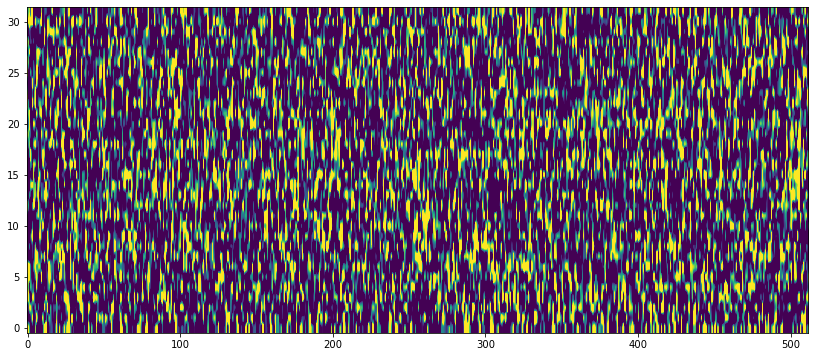

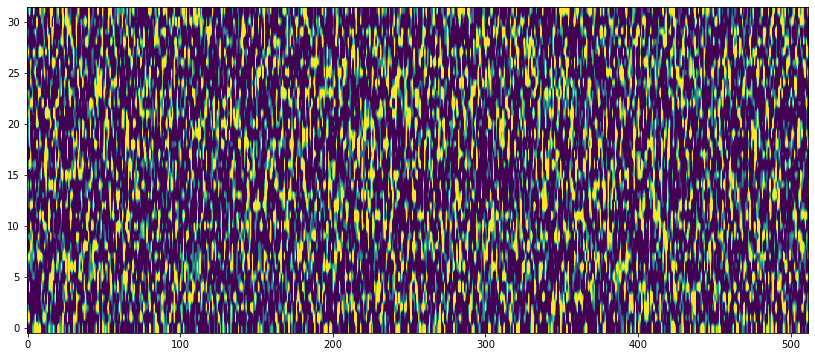

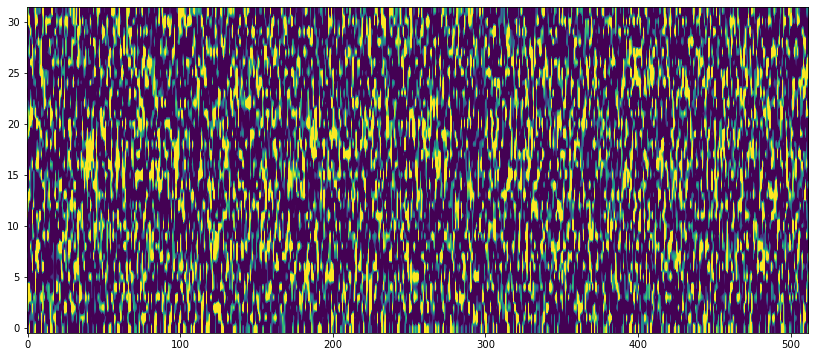

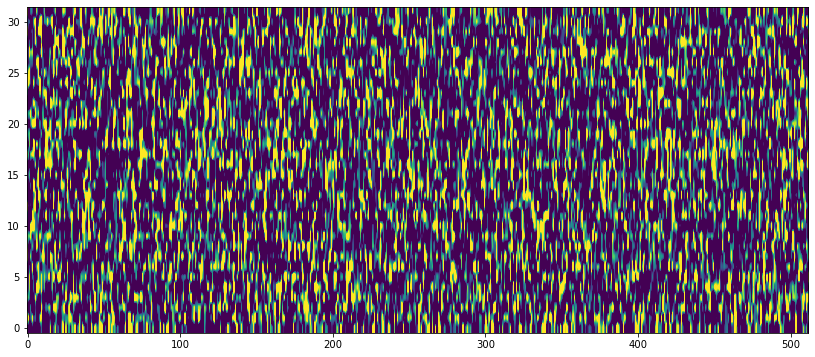

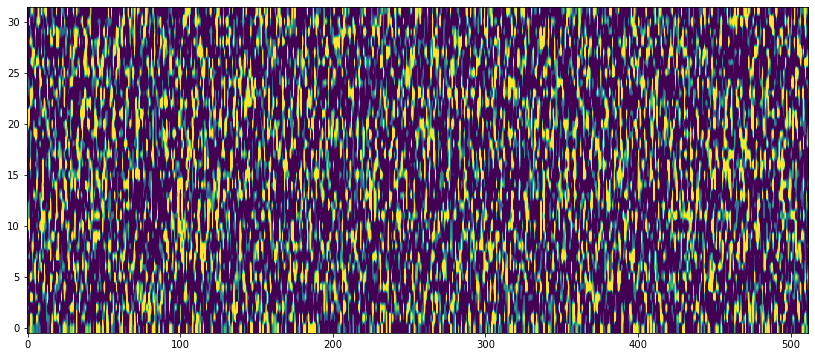

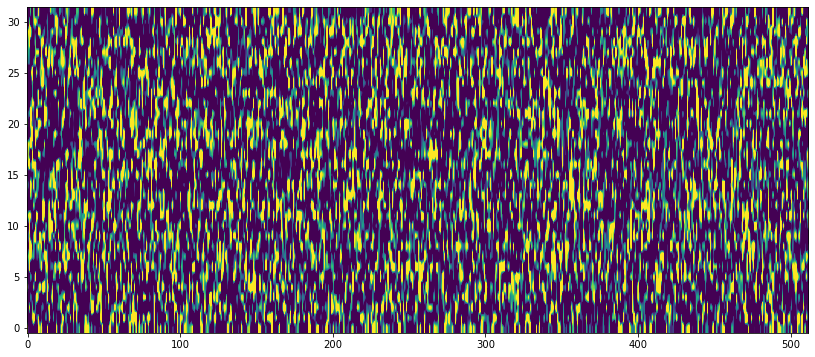

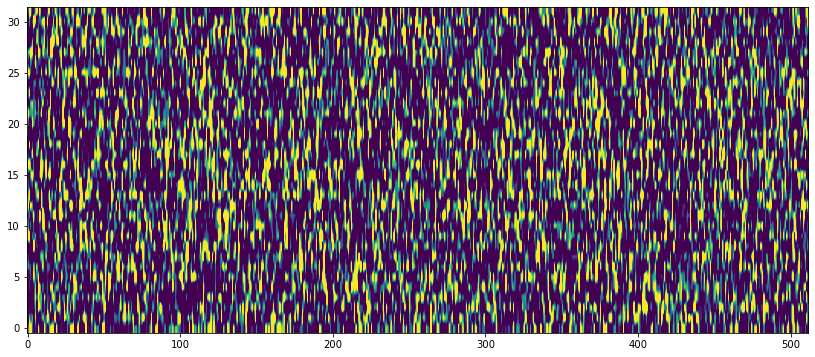

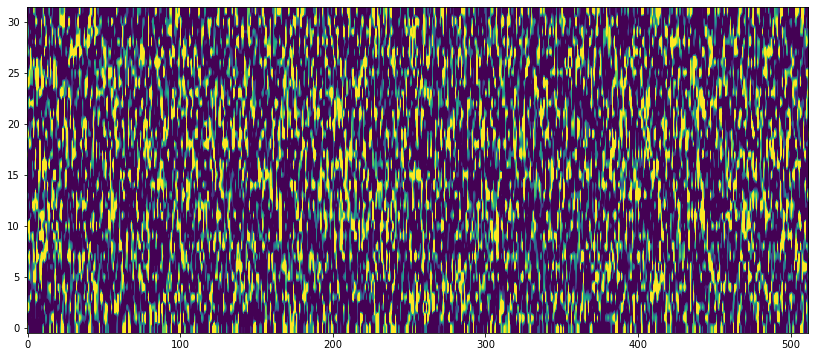

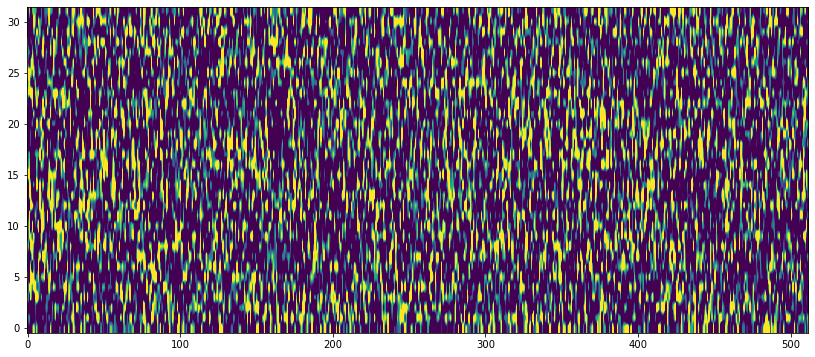

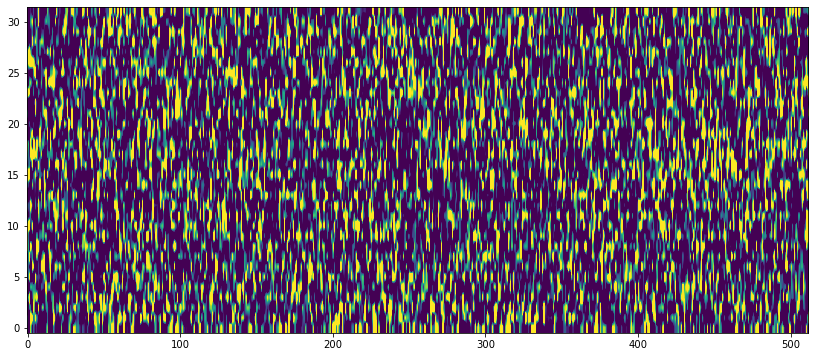

In [80]:
image_corr

%matplotlib inline
for i in range(0, 10):
    print(i)
    fig, ax = plt.subplots(1, 1, figsize=(14, 6))
    plt.imshow(image_corr[i,1,:,:,], origin = 'lower', aspect='auto',  vmin=0, vmax=10)

In [194]:
col_values= hdul[1].data[integr_num,group_num,:,col_num]
a_coeff, x = LS_fit_one(time_full[col_num], col_values)

col_values

array([ 76.17236 ,  55.2854  , 110.812256,  51.60547 ,   3.052246,
        -5.154541,  35.532227,  57.990723,  63.292236,  25.965332,
        28.771484,  66.22119 ,  71.372314,  72.36548 ,  14.185303,
        81.569336,  35.612305,  61.165527,  73.97217 ,  10.485352,
        54.402344,  -2.994629,  36.28247 ,  27.429688, -18.005615,
        87.50122 ,  70.29224 ,  69.64526 ,  36.500366, 104.60547 ,
        66.338135,  -3.921875], dtype=float32)

In [220]:
hdul[1].data[integr_num,group_num,:,col_num]

array([ 76.17236 ,  55.2854  , 110.812256,  51.60547 ,   3.052246,
        -5.154541,  35.532227,  57.990723,  63.292236,  25.965332,
        28.771484,  66.22119 ,  71.372314,  72.36548 ,  14.185303,
        81.569336,  35.612305,  61.165527,  73.97217 ,  10.485352,
        54.402344,  -2.994629,  36.28247 ,  27.429688, -18.005615,
        87.50122 ,  70.29224 ,  69.64526 ,  36.500366, 104.60547 ,
        66.338135,  -3.921875], dtype=float32)

In [81]:
hdul[1].data = image_corr

In [77]:
hdul[1].data

array([[[[-1.74647641e+01,  2.56588586e+01, -3.55468958e+00, ...,
           1.07447225e+01,  2.60732685e+01,  1.53745859e+00],
         [ 3.11808297e+01,  4.96964347e+00, -1.85999862e+00, ...,
          -1.01001078e+01,  3.62870460e+00, -1.07950176e+01],
         [ 3.59083326e+01,  6.06942467e+01, -6.51823975e+01, ...,
           4.72340170e+01, -1.70734277e+01, -6.63359738e+00],
         ...,
         [-9.34630526e+00,  5.98266502e+01,  3.64139713e+00, ...,
           3.19332422e+01,  3.05273499e+01,  1.24123716e+01],
         [ 2.29314906e+01,  2.17570640e+01,  4.24402141e+01, ...,
          -2.19021887e+01,  6.21335673e+01, -1.53995358e+01],
         [-2.70055572e+01, -4.83051980e+01, -6.25158518e+01, ...,
          -1.15407202e+01,  6.64685443e+01, -2.47585623e+01]],

        [[-3.25583007e+01,  2.28747677e+01,  3.22371951e+00, ...,
           3.94044095e+01,  2.33857685e+01,  9.18518583e+00],
         [ 1.67075118e+01,  1.18046875e+01,  1.44278730e+00, ...,
           1.22903056e

In [355]:
image_corr

array([[[[-5.10925140e+01,  2.56588586e+01, -3.55468958e+00, ...,
           1.07447225e+01,  2.60732685e+01,  1.53745859e+00],
         [-1.04299878e+00,  4.96964347e+00, -1.85999862e+00, ...,
          -1.01001078e+01,  3.62870460e+00, -1.07950176e+01],
         [ 5.08842567e+00,  6.06942467e+01, -6.51823975e+01, ...,
           4.72340170e+01, -1.70734277e+01, -6.63359738e+00],
         ...,
         [-2.26033118e+00,  5.98266502e+01,  3.64139713e+00, ...,
           3.19332422e+01,  3.05273499e+01,  1.24123716e+01],
         [ 3.14213862e+01,  2.17570640e+01,  4.24402141e+01, ...,
          -2.19021887e+01,  6.21335673e+01, -1.53995358e+01],
         [-1.71117401e+01, -4.83051980e+01, -6.25158518e+01, ...,
          -1.15407202e+01,  6.64685443e+01, -2.47585623e+01]],

        [[-6.60243322e+01,  2.28747677e+01,  3.22371951e+00, ...,
           3.39890408e+01,  2.33857685e+01,  9.18518583e+00],
         [-1.53622803e+01,  1.18046875e+01,  1.44278730e+00, ...,
          -4.11147131e

In [358]:
from astropy.io.fits import getheader
hdr = getheader("dc-roof/jwdata0010010_11010_0001_NRS1_uncal_updatedHDR_10INTS_ramp_STOPAFTERBIAS.fits", 0) 
hdr

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                    8 / array data type                                
NAXIS   =                    0 / number of array dimensions                     
EXTEND  =                    T                                                  
DATE    = '2022-03-21T19:37:31.874' / UTC date file created                     
ORIGIN  = 'STScI   '           / Organization responsible for creating file     
FILENAME= 'jwdata0010010_11010_0001_NRS1_uncal_updatedHDR_10INTS_ramp.fits' / Na
FILETYPE= 'countrate'          / Type of data in the file                       
SDP_VER = 'B7.0    '           / Data processing software version number        
CAL_VER = '1.3.3   '           / Calibration software version number            
CAL_VCS = 'RELEASE '           / Calibration software version control sys number
DATAMODL= 'RampModel'          / Type of data model                             
TELESCOP= 'JWST    '        

In [82]:
write =False #  True #

if write:
    hdul.writeto('dc-roof/ideal_one_over_f_nirspec_format_med_corr.fits')